# imports

In [72]:
import sys
sys.path.append('./lib')

import os
import h5py
import optuna

# setup paths
iteration = 1 # which version of this tutorial to run (in case want results in different dirs)
NBname = 'color_cloud_initial{}'.format(iteration)

myhost = os.uname()[1] # get name of machine
print("Running on Computer: [%s]" %myhost)

datadir = '/home/dbutts/ColorV1/Data/'
dirname = '/home/dbutts/ColorV1/CLRworkspace/' # Working directory 

import numpy as np
import torch
import pickle
import os
import optuna
from time import time
import scipy.io as sio
import matplotlib.pyplot as plt
import scipy.io as sio
import matplotlib
from copy import deepcopy

# plotting
import matplotlib.pyplot as plt

# Import torch
import torch
from torch import nn

# NDN tools
import NDNT.utils as utils # some other utilities
import NDNT.NDNT as NDN
from NDNT.modules.layers import NDNLayer, ConvLayer, STconvLayer, Tlayer, ChannelLayer, IterSTlayer, ReadoutLayer
from NDNT.networks import FFnetwork
from time import time
import dill

from NTdatasets.generic import GenericDataset
import NTdatasets.conway.cloud_datasets as datasets

# Utilities
import ColorDataUtils.ConwayUtils as CU
import ColorDataUtils.EyeTrackingUtils as ETutils
from NDNT.utils import imagesc   # because I'm lazy
from NDNT.utils import ss        # because I'm real lazy

device = torch.device("cuda:1")
dtype = torch.float32

# Where saved models and checkpoints go -- this is to be automated
print( 'Save_dir =', dirname)
print(device)
%load_ext autoreload
%autoreload 2

torch.cuda.empty_cache()

class Model:
    def __init__(self, ndn_model, LLs, trial):
        self.ndn_model = ndn_model
        self.LLs = LLs
        self.trial = trial

Running on Computer: [ca1]
Save_dir = /home/dbutts/ColorV1/CLRworkspace/
cuda:1
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# load data

In [73]:
fn = 'Jocamo_220715_full_CC_ETCC_nofix_v08'
num_lags=16

t0 = time()
data = datasets.ColorClouds(
    datadir=datadir, filenames=[fn], eye_config=3, drift_interval=16,
    luminance_only=True, binocular=False, include_MUs=True, num_lags=num_lags,
    trial_sample=True)
t1 = time()
print(t1-t0, 'sec elapsed')

NT = data.robs.shape[0]
NA = data.Xdrift.shape[1]
print("%d (%d valid) time points"%(NT, len(data)))
#data.valid_inds = np.arange(NT, dtype=np.int64)

lam_units = np.where(data.channel_map < 32)[0]
ETunits = np.where(data.channel_map >= 32)[0]
UTunits = np.where(data.channel_map >= 32+127)[0]

print( "%d laminar units, %d ET units"%(len(lam_units), len(ETunits)))

# Replace DFs
matdat = sio.loadmat(datadir+'Jocamo_220715_full_CC_ETCC_nofix_v08_DFextra.mat')
data.dfs = torch.tensor( matdat['XDF'][:NT, :], dtype=torch.float32 )

# Pull correct saccades
matdat = sio.loadmat( datadir+'Jocamo_220715_full_CC_ETCC_v08_ETupdate.mat')
sac_ts_all = matdat['ALLsac_bins'][0, :]

data.process_fixations( sac_ts_all )
sac_tsB = matdat['sac_binsB'][0, :]
sac_tsL = matdat['sac_binsL'][0, :]
sac_tsR = matdat['sac_binsR'][0, :]

NFIX = torch.max(data.fix_n).detach().numpy()
print(NFIX, 'fixations')
et1kHzB = matdat['et1kHzB']
et60B = matdat['et60HzB']
et60all = matdat['et60Hz_all']

Reducing stimulus channels (3) to first dimension
Loading data into memory...
Adjusting stimulus read from disk: mean | std = -0.000 | 0.269
T-range: 0 167520
  Trimming experiment 365280->167520 time points based on eye_config and Tmax
118.4574842453003 sec elapsed
167520 (167520 valid) time points
29 laminar units, 210 ET units
  Redoing fix_n with saccade inputs: 6827 saccades
3795 fixations


In [74]:
# Set cells-to-analyze and pull best model configuration and mus
Reff = torch.mul(data.robs[:, UTunits], data.dfs[:, UTunits]).numpy()
nspks = np.sum(Reff, axis=0)
a = np.where(nspks > 10)[0]
valET = UTunits[a]
NCv = len(valET)
print("%d out of %d units used"%(len(valET), len(UTunits)))

## CONVERT LLsNULL, which is based on 

# Read in previous data
dirname2 = dirname+'0715/et/'
matdat = sio.loadmat(dirname2+'LLsGLM.mat')
Dreg = matdat['Dreg']
top_corner = matdat['top_corner'][:, 0]

data.set_cells(valET)

174 out of 195 units used
Output set to 174 cells


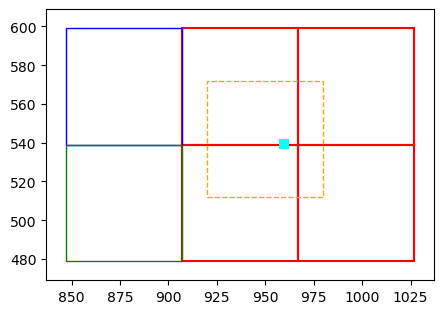

  Stim expansion for shift: [900, 492, 1000, 592]
  Writing lam stim 0: overlap 60, 47
  Writing lam stim 1: overlap 60, 53
  Writing lam stim 2: overlap 33, 53
  Writing lam stim 3: overlap 33, 47
  Writing ETstim 0: overlap 7, 53
  Writing ETstim 1: overlap 7, 47
  Adding fixation point
  Shifting stim...
  CROP: New stim size: 60 x 60
  Done


In [75]:
# Load shifts and previous models
dirname2 = dirname+'0715/et/'
SHfile = sio.loadmat( dirname2 + 'BDshifts1.mat' )
fix_n = SHfile['fix_n']
shifts = SHfile['shifts']
metricsLL = SHfile['metricsLL']
metricsTH = SHfile['metricsTH']
ETshifts = SHfile['ETshifts']
ETmetrics = SHfile['ETmetrics']
Ukeeps = SHfile['Ctrain']
XVkeeps = SHfile['Cval']

# Make 60x60 STAs (and GLMs)
Xshift = 14 #8+4 
Yshift = -3 #-10+4
NX = 60

new_tc = np.array([top_corner[0]-Xshift, top_corner[1]-Yshift], dtype=np.int64)
data.draw_stim_locations(top_corner = new_tc, L=NX)

data.assemble_stimulus(top_corner=[new_tc[0], new_tc[1]], L=NX, fixdot=0, shifts=-shifts)

In [76]:
goodfix = np.where(ETmetrics[:,1] < 0.80)[0]
valfix = torch.zeros([ETmetrics.shape[0], 1], dtype=torch.float32)
valfix[goodfix] = 1.0
# Test base-level performance (full DFs and then modify DFs)
#DFsave = deepcopy(data2.dfs)  # this is also in data.dfs
data.dfs_out *= valfix
("%0.1f%% fixations remaining"%(100*len(goodfix)/ETmetrics.shape[0]))
dirname2 = dirname+'0715/NewGLMs/'
matdat = sio.loadmat(dirname2+'J0715ProcGLMinfo.mat')

data.dfs.shape

 # STAs

In [7]:
data.num_lags, data.stim.shape, data.robs.shape

(10, torch.Size([167520, 3600]), torch.Size([167520, 239]))

In [8]:
print(valET)

[ 20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37
  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55
  56  57  58  59  60  61  62  63  64  66  67  68  69  70  71  72  73  75
  77  78  79  80  81  82  83  84  86  87  88  89  90  92  93  95  96  97
  98  99 100 101 103 104 105 106 107 108 109 110 111 112 113 114 115 116
 117 118 119 120 121 122 123 124 125 126 127 152 153 154 155 156 157 159
 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177
 178 179 180 182 183 184 185 187 188 189 190 191 192 193 194 195 196 197
 198 200 203 204 205 206 207 208 209 210 211 213 214 216 217 218 219 220
 221 222 224 226 227 228 230 231 232 233 235 236]


In [49]:
Reff = torch.mul(data.robs[:, valET], data.dfs[:, valET])
nspks = torch.sum(Reff, axis=0)
lag = 4
stas = ((data.stim[:-lag, ...].T @ Reff[lag:,:]).squeeze() / nspks).reshape([60,60,-1]).numpy()
stas.shape

IndexError: index 174 is out of bounds for dimension 0 with size 174

In [10]:
# plot some STAs
ss(29,6)
for cc in range(NCv):
    plt.subplot(29,6, cc+1)
    imagesc(stas[:,:, cc])
    plt.title(str(cc) + ' -- ' + str(valET[cc]))
plt.show()

# interesting cells

STAs


NameError: name 'stas' is not defined

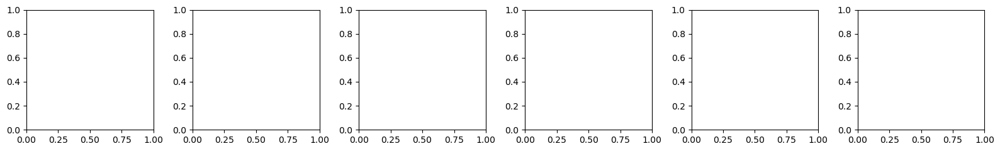

In [48]:
interesting_cells = [18, 24, 38, 46, 54, 57]

print("STAs")
ss(1,len(interesting_cells))
col = 1
for cc in interesting_cells:
    plt.subplot(1,len(interesting_cells), col)
    imagesc(stas[:,:, cc])
    plt.title('STA cc: ' + str(valET[cc]))
    col += 1
plt.show()

print("GLMs")
for cc in interesting_cells:
    max_weights = np.max(glms[cc].ndn_model.networks[0].layers[0].get_weights())
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(glms[cc].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GLM, cc(valET): ' + str(cc) + ', cc(All): ' + str(valET[cc]) + ', LL: ' + str(glms[cc].LLs))
        col += 1
    plt.show()

print("GQMs")

for cc in interesting_cells:
    max_weights = 0
    weights_lin = np.max(gqms[cc].ndn_model.networks[0].layers[0].get_weights())
    weights_quad = np.max(gqms[cc].ndn_model.networks[2].layers[0].get_weights())
    if weights_lin > max_weights:
        max_weights = weights_lin
    if weights_quad > max_weights:
        max_weights = weights_quad
    
    print('-------------')
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(gqms[cc].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - linear, cc(valET): ' + str(cc) + ', cc(All): ' + str(valET[cc]) + ', LL: ' + str(gqms[cc].LLs))
        col += 1
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(gqms[cc].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - quad0, cc(valET): ' + str(cc) + ', cc(All): ' + str(valET[cc]))
        col += 1
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(gqms[cc].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 1], max=max_weights)
        plt.suptitle('GQM - quad1, cc(valET): ' + str(cc) + ', cc(All): ' + str(valET[cc]))
        col += 1
    plt.show()

# define models

In [53]:
#set up fits
Treg = 1
Xreg = 20 # [20]
L1reg = 0.1 # [0.5]
GLreg = 10.0 # [4.0]

# drift network
drift_pars1 = NDNLayer.layer_dict(
    input_dims=[1,1,1,NA], num_filters=1, bias=False, norm_type=0, NLtype='lin')
drift_pars1['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} }
# for stand-alone drift model
drift_pars1N = deepcopy(drift_pars1)
drift_pars1N['NLtype'] = 'softplus'
drift_net =  FFnetwork.ffnet_dict( xstim_n = 'Xdrift', layer_list = [drift_pars1] )

# glm net
glm_layer = Tlayer.layer_dict(
    input_dims=data.stim_dims, num_filters=1, bias=False, num_lags=num_lags,
    NLtype='lin', initialize_center = True)
glm_layer['reg_vals'] = {'d2x': Xreg, 'd2t': Treg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':10}
stim_net =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm_layer] )

# gqm net
num_subs = 2
gqm_layer = Tlayer.layer_dict(
    input_dims=data.stim_dims, num_filters=num_subs, num_inh=0, bias=False, num_lags=num_lags,
    NLtype='square', initialize_center = True)
gqm_layer['reg_vals'] = {'d2x': Xreg, 'd2t': Treg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':10}
stim_qnet =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [gqm_layer] )

#combine glm
comb_layer = NDNLayer.layer_dict(
    num_filters = 1, NLtype='softplus', bias=False)
comb_layer['weights_initializer'] = 'ones'

net_comb = FFnetwork.ffnet_dict(
    xstim_n = None, ffnet_n=[0,1],
    layer_list = [comb_layer], ffnet_type='add')

#combine gqm
comb2_layer = ChannelLayer.layer_dict(
    num_filters = 1, NLtype='softplus', bias=False)
comb2_layer['weights_initializer'] = 'ones'

net2_comb = FFnetwork.ffnet_dict(
    xstim_n = None, ffnet_n=[0,1,2],
    layer_list = [comb2_layer], ffnet_type='normal')
net2_comb['layer_list'][0]['bias'] = True

# Drifts

## fit Drifts

In [41]:
def fit_drift(i, cc, folder):
    drift_model_filename = 'models/'+folder+'/drift_model_cc'+str(valET[cc])+'.pkl'
    drift_study_filename = 'models/'+folder+'/drift_study_cc'+str(valET[cc])+'.pkl'

    # continue if the file already exists
    if os.path.isfile(drift_model_filename):
        # load the model and continue
        print('loading model', cc)
        with open(drift_model_filename, 'rb') as f:
            drift = pickle.load(f)
        with open(drift_study_filename, 'rb') as f:
            study = pickle.load(f)
        return drift, study

    #data.set_cells(valET[cc])
    data.set_cells(cc)

    drifts_temp = []

    def objective(trial):
        lbfgs_pars = utils.create_optimizer_params(
            optimizer_type='lbfgs',
            tolerance_change=1e-8,
            tolerance_grad=1e-8,
            history_size=100,
            batch_size=20,
            max_epochs=3,
            max_iter = 500,
            device = device)

        # drift network
        drift_pars1 = NDNLayer.layer_dict(
            input_dims=[1,1,1,NA], num_filters=1, bias=False, norm_type=0, NLtype='lin')
        drift_pars1['reg_vals'] = {'d2t': trial.suggest_float('d2t', 0.0, 1.0), 'bcs':{'d2t':0} }
        # for stand-alone drift model
        drift_pars1N = deepcopy(drift_pars1)
        drift_pars1N['NLtype'] = 'softplus'
        drift_net =  FFnetwork.ffnet_dict( xstim_n = 'Xdrift', layer_list = [drift_pars1] )

        drift_ndn = NDN.NDN(
            layer_list = [drift_pars1N], loss_type='poisson')
        drift_ndn.block_sample=True
        drift_ndn.networks[0].xstim_n = 'Xdrift'

        drift_ndn.fit( data, force_dict_training=True, train_inds=None, **lbfgs_pars, verbose=0, version=1)
        LL = drift_ndn.eval_models(data[data.val_blks], null_adjusted=False)[0]

        drift_model = Model(drift_ndn, LL, trial)
        drifts_temp.append(drift_model)

        return LL

    study = optuna.create_study(direction='minimize')

    # enqueue initial parameters
    study.enqueue_trial(
        {'d2t': Dreg})

    study.optimize(objective, n_trials=2)

    best_model = drifts_temp[study.best_trial.number]

    drifts.append(best_model)

    with open(drift_model_filename, 'wb') as f:
        pickle.dump(best_model, f)

    with open(drift_study_filename, 'wb') as f:
        pickle.dump(study, f)

    print(study.best_trial.number, study.best_params)
    return best_model, study

In [42]:
drifts = []
for i, cc in enumerate(range(NCv)):
    drift = fit_drift(i, cc, 'glms_03')[0]
    drifts.append(drift)

loading model 0
loading model 1
loading model 2
loading model 3
loading model 4
loading model 5
loading model 6
loading model 7
loading model 8
loading model 9
loading model 10
loading model 11
loading model 12
loading model 13
loading model 14
loading model 15
loading model 16
loading model 17
loading model 18
loading model 19
loading model 20
loading model 21
loading model 22
loading model 23
loading model 24
loading model 25
loading model 26
loading model 27
loading model 28
loading model 29
loading model 30
loading model 31
loading model 32
loading model 33
loading model 34
loading model 35
loading model 36
loading model 37
loading model 38
loading model 39
loading model 40
loading model 41
loading model 42
loading model 43
loading model 44
loading model 45
loading model 46
loading model 47
loading model 48
loading model 49
loading model 50
loading model 51
loading model 52
loading model 53
loading model 54
loading model 55
loading model 56
loading model 57
loading model 58
loading

## plot Drifts

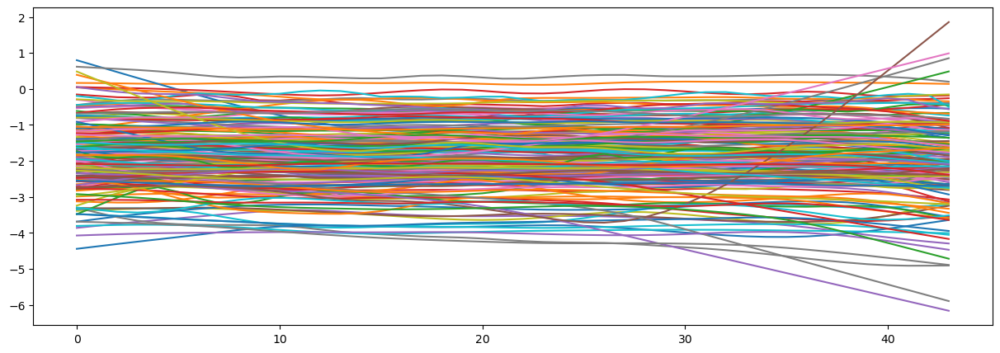

In [33]:
fig = plt.figure(figsize=(15,5))
for drift in drifts:
    plt.plot(drift.ndn_model.networks[0].layers[0].get_weights())

# GLMs

## fit GLMs

In [34]:
def fit_glm(i, cc, folder):
    glm_model_filename = 'models/'+folder+'/glm_model_cc'+str(valET[cc])+'.pkl'
    glm_study_filename = 'models/'+folder+'/glm_study_cc'+str(valET[cc])+'.pkl'

    drift_weights = drifts[i].ndn_model.networks[0].layers[0].weight.data[:,0]

    # continue if the file already exists
    if os.path.isfile(glm_model_filename):
        # load the model and continue
        print('loading model', cc)
        with open(glm_model_filename, 'rb') as f:
            glm = pickle.load(f)
        with open(glm_study_filename, 'rb') as f:
            study = pickle.load(f)
        return glm, study

    #data.set_cells(valET[cc])
    data.set_cells(cc)

    LLsNULL = drifts[i].LLs

    glm = NDN.NDN(ffnet_list = [stim_net, drift_net, net_comb], loss_type='poisson')
    glm.block_sample=True
    glm.networks[1].layers[0].weight.data[:,0] = deepcopy(drift_weights)
    glm.networks[1].layers[0].set_parameters(val=False)
    glm.networks[2].layers[0].set_parameters(val=False,name='weight')

    glms_temp = []

    def objective(trial):
        lbfgs_pars = utils.create_optimizer_params(
            optimizer_type='lbfgs',
            tolerance_change=trial.suggest_float('tolerance_change', 1e-10, 1e-6),
            tolerance_grad=trial.suggest_float('tolerance_grad', 1e-10, 1e-6),
            history_size=100,
            batch_size=20,
            max_epochs=3,
            max_iter=500,
            device=device)

        glm.networks[0].layers[0].reg.vals['d2x'] = trial.suggest_float('d2x', 10, 30)
        glm.networks[0].layers[0].reg.vals['d2t'] = trial.suggest_float('d2t', 0.5, 2)
        glm.networks[0].layers[0].reg.vals['d2xt'] = trial.suggest_float('d2xt', 0.001, 10000)
        glm.networks[0].layers[0].reg.vals['l1'] = trial.suggest_float('l1', 0.01, 1)
        glm.networks[0].layers[0].reg.vals['glocalx'] = trial.suggest_float('glocalx', 0.001, 20)

        glm.fit(data, force_dict_training=True, trial=trial, **lbfgs_pars)
        LL = glm.eval_models(data[data.val_blks], null_adjusted=False)[0]

        null_adjusted_LL = LLsNULL - LL

        glm_model = Model(glm, null_adjusted_LL, trial)
        glms_temp.append(glm_model)

        return null_adjusted_LL

    study = optuna.create_study(direction='maximize')

    # enqueue initial parameters
    study.enqueue_trial(
        {'d2t': 1,
         'd2x': 20,
         'd2xt': 0.001,
         'l1': 0.1,
         'glocalx': 10.0,
         'tolerance_change': 1e-8,
         'tolerance_grad': 1e-8})
    study.enqueue_trial(
        {'d2t': 1,
         'd2x': 20,
         'd2xt': 0.01,
         'l1': 0.1,
         'glocalx': 10.0,
         'tolerance_change': 1e-8,
         'tolerance_grad': 1e-8})
    study.enqueue_trial(
        {'d2t': 1,
         'd2x': 20,
         'd2xt': 0.1,
         'l1': 0.1,
         'glocalx': 10.0,
         'tolerance_change': 1e-8,
         'tolerance_grad': 1e-8})
    study.enqueue_trial(
        {'d2t': 1,
         'd2x': 20,
         'd2xt': 1,
         'l1': 0.1,
         'glocalx': 10.0,
         'tolerance_change': 1e-8,
         'tolerance_grad': 1e-8})
    study.enqueue_trial(
        {'d2t': 1,
         'd2x': 20,
         'd2xt': 10,
         'l1': 0.1,
         'glocalx': 10.0,
         'tolerance_change': 1e-8,
         'tolerance_grad': 1e-8})

    study.optimize(objective, n_trials=20)

    best_model = glms_temp[study.best_trial.number]

    glms.append(best_model)

    # save the model
    with open(glm_model_filename, 'wb') as f:
        pickle.dump(best_model, f)

    # save the study
    with open(glm_study_filename, 'wb') as f:
        pickle.dump(study, f)

    print(study.best_trial.number, study.best_params)
    return best_model, study

In [35]:
glms = []
for i, cc in enumerate(range(NCv)):
    glms.append(fit_glm(cc, i, folder='glms_03')[0])

loading model 0
loading model 1
loading model 2
loading model 3
loading model 4
loading model 5
loading model 6
loading model 7
loading model 8
loading model 9
loading model 10
loading model 11
loading model 12
loading model 13
loading model 14
loading model 15
loading model 16
loading model 17
loading model 18
loading model 19
loading model 20
loading model 21
loading model 22
loading model 23
loading model 24
loading model 25
loading model 26
loading model 27
loading model 28
loading model 29
loading model 30
loading model 31
loading model 32
loading model 33
loading model 34
loading model 35
loading model 36
loading model 37
loading model 38
loading model 39
loading model 40
loading model 41
loading model 42
loading model 43
loading model 44
loading model 45
loading model 46
loading model 47
loading model 48
loading model 49
loading model 50
loading model 51
loading model 52
loading model 53
loading model 54
loading model 55
loading model 56
loading model 57
loading model 58
loading

## plot GLMs

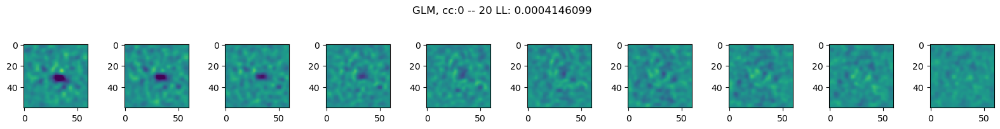

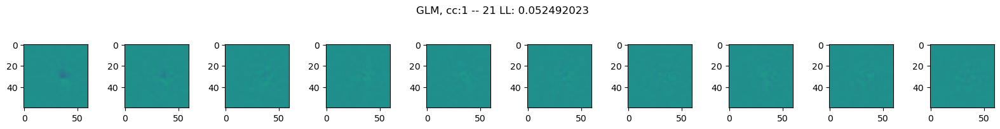

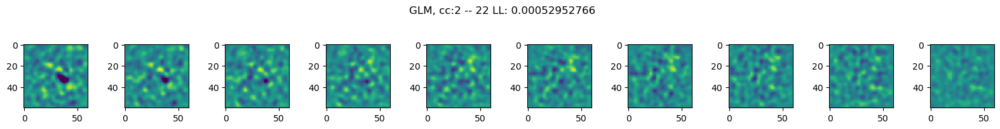

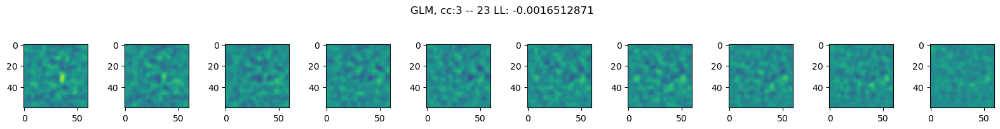

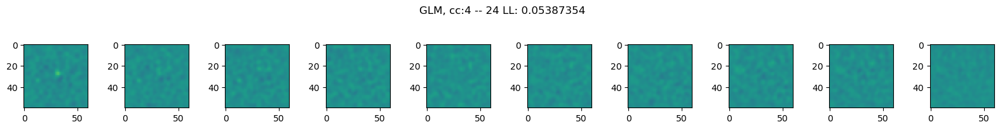

...

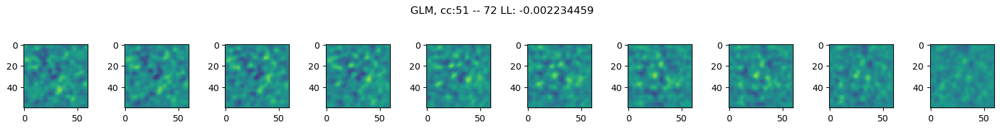

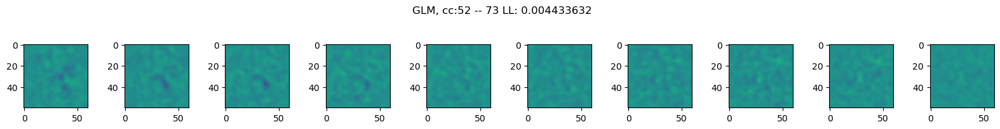

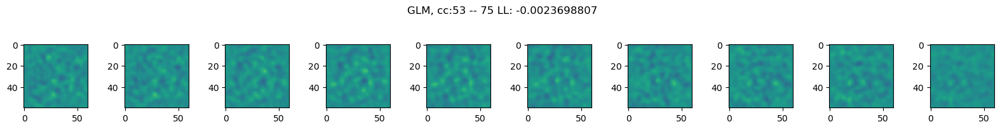

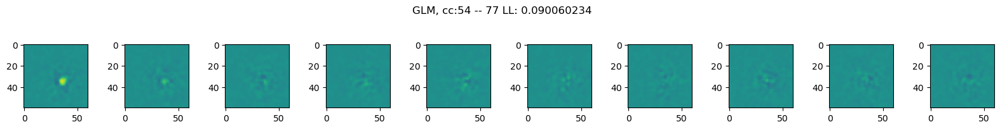

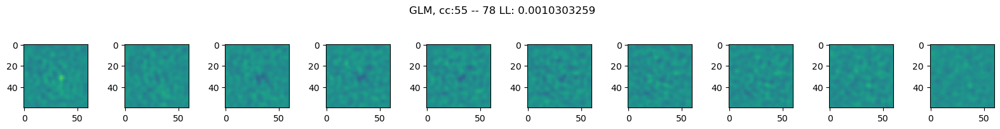

In [26]:
for i in range(0, 56):
    max_weights = np.max(glms[i].ndn_model.networks[0].layers[0].get_weights())
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(glms[i].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GLM, cc:' + str(i) + ' -- ' + str(valET[i]) + ' LL: ' + str(glms[i].LLs))
        col += 1
    plt.show()

0.0019235611
0.053796053
0.02038598
0.0631547
0.013866425


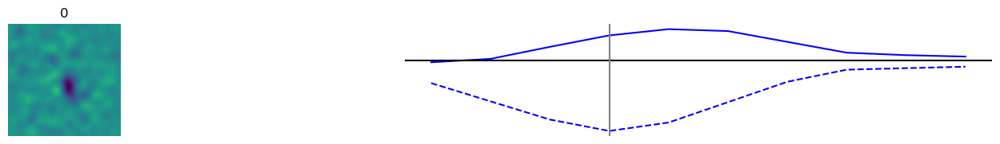

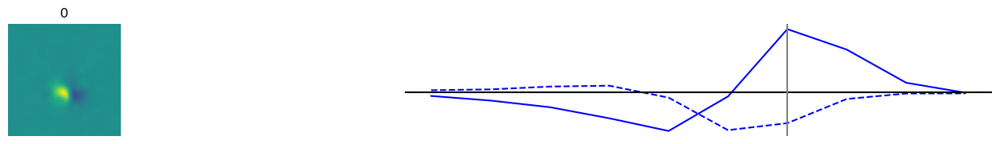

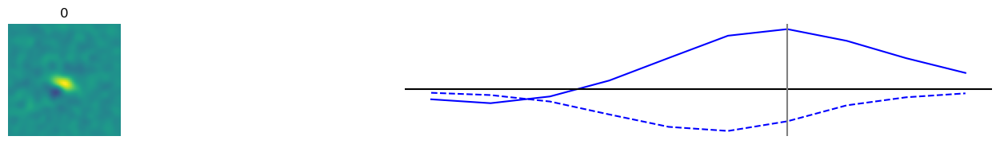

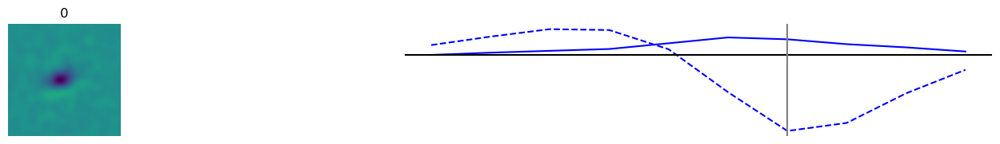

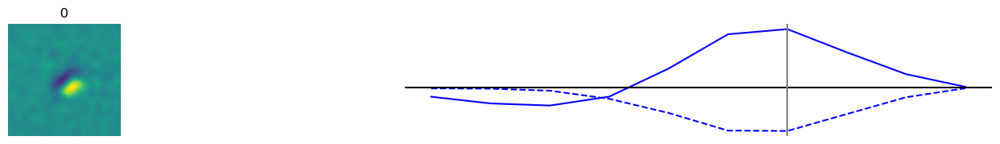

In [118]:
for glm in glms:
    print(glm.LLs)
    glm.ndn_model.plot_filters()

# GQMs

## fit GQMs

In [37]:
def fit_gqm(i, cc, folder):
    gqm_model_filename = 'models/'+folder+'/gqm_model_cc'+str(valET[cc])+'.pkl'
    gqm_study_filename = 'models/'+folder+'/gqm_study_cc'+str(valET[cc])+'.pkl'
    
    drift_weights = drifts[i].ndn_model.networks[0].layers[0].weight.data[:,0]
    
    # continue if the file already exists
    if os.path.isfile(gqm_model_filename):
        # load the model and continue
        print('loading model', cc)
        with open(gqm_model_filename, 'rb') as f:
            gqm = pickle.load(f)
        with open(gqm_study_filename, 'rb') as f:
            study = pickle.load(f)
        return gqm, study

    #data.set_cells(valET[cc])
    data.set_cells(cc)
    
    LLsNULL = drifts[i].LLs
    
    # get the best reg_vals for the GLM
    best_reg_vals = glms[i].ndn_model.networks[0].layers[0].reg.vals
    stim_net['layer_list'][0]['reg_vals'] = deepcopy(best_reg_vals)
    gqm = NDN.NDN(ffnet_list = [stim_net, drift_net, stim_qnet, net2_comb], loss_type='poisson')
    gqm.networks[0].layers[0] = deepcopy(glms[i].ndn_model.networks[0].layers[0])
    gqm.block_sample=True
    gqm.networks[3].layers[0].set_parameters(val=False,name='weight')
    gqm.networks[1].layers[0].weight.data[:,0] = deepcopy(drift_weights)
    gqm.networks[1].layers[0].set_parameters(val=False)
    
    gqms_temp = []
    
    def objective(trial):
        lbfgs_pars = utils.create_optimizer_params(
            optimizer_type='lbfgs',
            tolerance_change=trial.suggest_float('tolerance_change', 1e-10, 1e-6),
            tolerance_grad=trial.suggest_float('tolerance_grad', 1e-10, 1e-6),
            history_size=100,
            batch_size=20,
            max_epochs=3,
            max_iter = 500,
            device = device)
    
        # gqm.networks[0].layers[0].reg.vals['d2x'] = trial.suggest_float('lin_d2x', 10, 30)
        # gqm.networks[0].layers[0].reg.vals['d2t'] = trial.suggest_float('lin_d2t', 0.5, 2)
        # gqm.networks[0].layers[0].reg.vals['d2xt'] = trial.suggest_float('lin_d2xt', 0.001, 10000)
        # gqm.networks[0].layers[0].reg.vals['l1'] = trial.suggest_float('lin_l1', 0.01, 1)
        # gqm.networks[0].layers[0].reg.vals['glocalx'] = trial.suggest_float('lin_glocalx', 0.001, 20)
    
        gqm.networks[2].layers[0].reg.vals['d2x'] = trial.suggest_float('quad_d2x', 10, 30)
        gqm.networks[2].layers[0].reg.vals['d2t'] = trial.suggest_float('quad_d2t', 0.5, 2)
        gqm.networks[2].layers[0].reg.vals['d2xt'] = trial.suggest_float('quad_d2xt', 0.001, 10000)
        gqm.networks[2].layers[0].reg.vals['l1'] = trial.suggest_float('quad_la', 0.01, 1)
        gqm.networks[2].layers[0].reg.vals['glocalx'] = trial.suggest_float('quad_glocalx', 0.001, 20)
    
        gqm.fit( data, force_dict_training=True, **lbfgs_pars)
        LL = gqm.eval_models(data[data.val_blks], null_adjusted=False)[0]
    
        null_adjusted_LL = LLsNULL - LL
    
        gqm_model = Model(gqm, null_adjusted_LL, trial)
        gqms_temp.append(gqm_model)
    
        return null_adjusted_LL
    
    study = optuna.create_study(direction='maximize')
    
    # enqueue initial parameters
    study.enqueue_trial(
        {'quad_d2t': 1,
         'quad_d2x': 20,
         'quad_d2xt': 0.001,
         'quad_l1': 0.1,
         'quad_glocalx': 10.0,
         'tolerance_change': 1e-8,
         'tolerance_grad': 1e-8})
    study.enqueue_trial(
        {'quad_d2t': 1,
         'quad_d2x': 20,
         'quad_d2xt': 0.01,
         'quad_l1': 0.1,
         'quad_glocalx': 10.0,
         'tolerance_change': 1e-8,
         'tolerance_grad': 1e-8})
    study.enqueue_trial(
        {'quad_d2t': 1,
         'quad_d2x': 20,
         'quad_d2xt': 0.1,
         'quad_l1': 0.1,
         'quad_glocalx': 10.0,
         'tolerance_change': 1e-8,
         'tolerance_grad': 1e-8})
    study.enqueue_trial(
        {'quad_d2t': 1,
         'quad_d2x': 20,
         'quad_d2xt': 1,
         'quad_l1': 0.1,
         'quad_glocalx': 10.0,
         'tolerance_change': 1e-8,
         'tolerance_grad': 1e-8})
    study.enqueue_trial(
        {'quad_d2t': 1,
         'quad_d2x': 20,
         'quad_d2xt': 10,
         'quad_l1': 0.1,
         'quad_glocalx': 10.0,
         'tolerance_change': 1e-8,
         'tolerance_grad': 1e-8})
    
    study.optimize(objective, n_trials=20)
    
    best_model = gqms_temp[study.best_trial.number]
    
    gqms.append(best_model)
    
    with open(gqm_model_filename, 'wb') as f:
        pickle.dump(best_model, f)
    
    with open(gqm_study_filename, 'wb') as f:
        pickle.dump(study, f)
    
    print(study.best_trial.number, study.best_params)
    return best_model, study

In [38]:
gqms = []
gqm_studies = []
for i, cc in enumerate(range(0, 84)):
    gqm, study = fit_gqm(i, cc, 'glms_03')
    gqms.append(gqm)
    gqm_studies.append(study)

loading model 0
loading model 1
loading model 2
loading model 3
loading model 4
loading model 5
loading model 6
loading model 7
loading model 8
loading model 9
loading model 10
loading model 11
loading model 12
loading model 13
loading model 14
loading model 15
loading model 16
loading model 17
loading model 18
loading model 19
loading model 20
loading model 21
loading model 22
loading model 23
loading model 24
loading model 25
loading model 26
loading model 27
loading model 28
loading model 29
loading model 30
loading model 31
loading model 32
loading model 33
loading model 34
loading model 35
loading model 36
loading model 37
loading model 38
loading model 39
loading model 40
loading model 41
loading model 42
loading model 43
loading model 44
loading model 45
loading model 46
loading model 47
loading model 48
loading model 49
loading model 50
loading model 51
loading model 52
loading model 53
loading model 54
loading model 55
loading model 56
loading model 57
loading model 58
loading

## plot GQMs

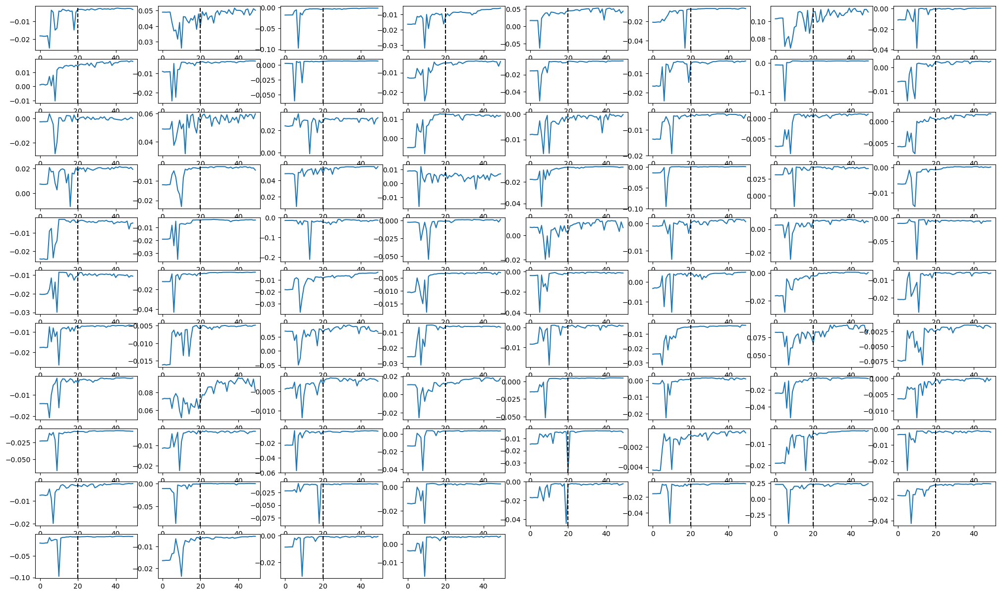

In [12]:
# plot GQM study
fig = plt.figure(figsize=(25, 15))
grid = plt.GridSpec(11, 8, hspace=0.2, wspace=0.2)
for i in range(84):
    row,col = np.unravel_index(i, (11,8))
    ax = fig.add_subplot(grid[row,col])
    ax.plot(gqm_studies[i].trials_dataframe()['value'])
    # draw vertical line
    ax.axvline(x=20, color='k', linestyle='--')

-------------


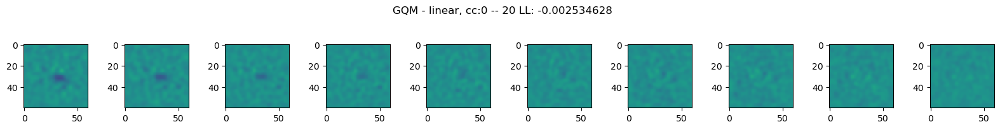

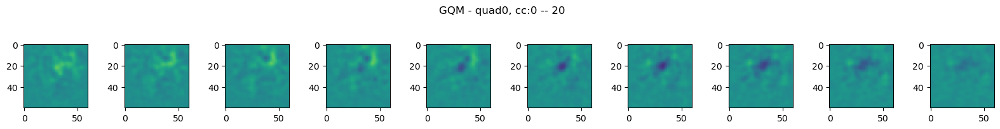

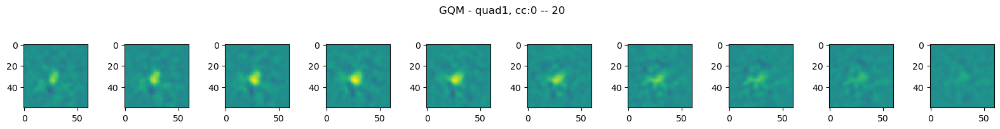

-------------


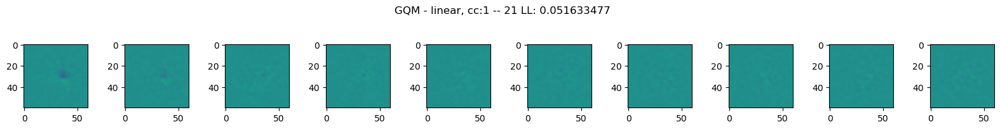

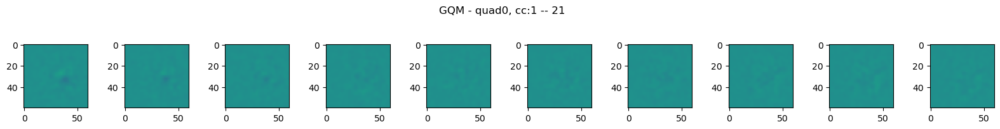

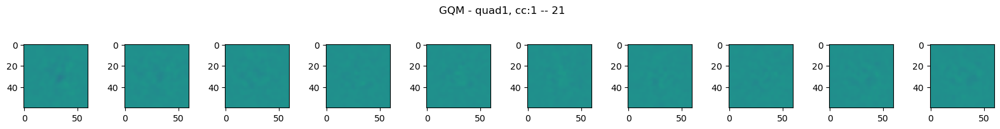

-------------


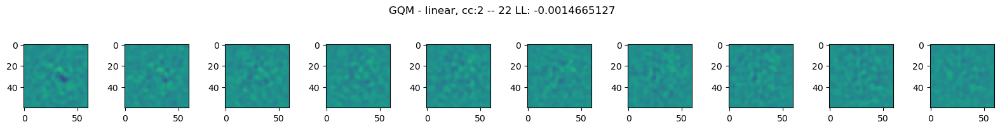

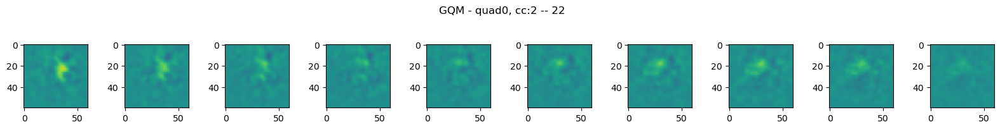

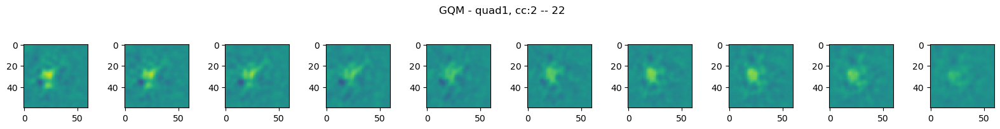

-------------


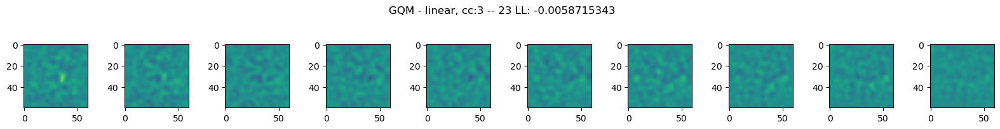

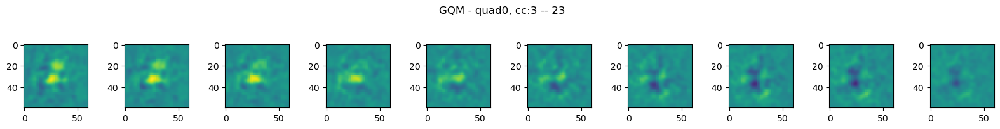

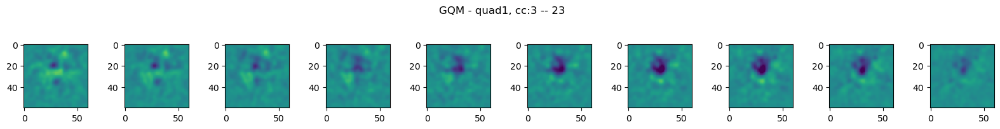

-------------


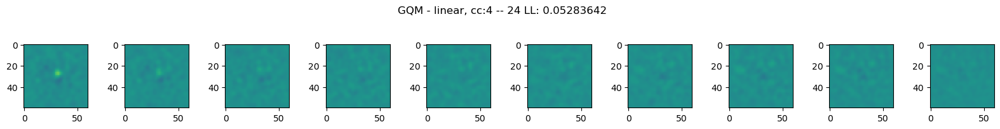

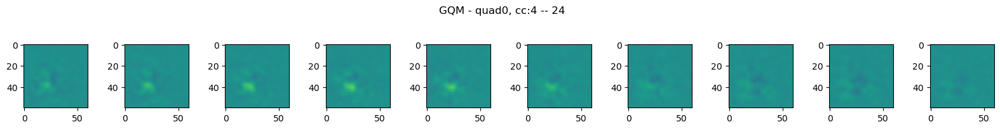

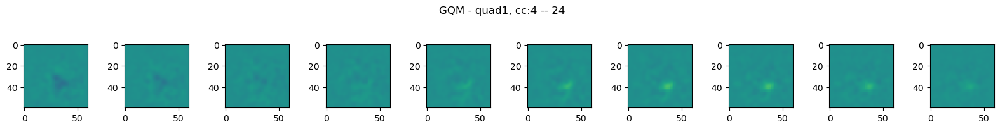

-------------


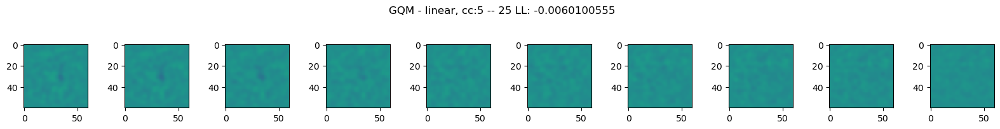

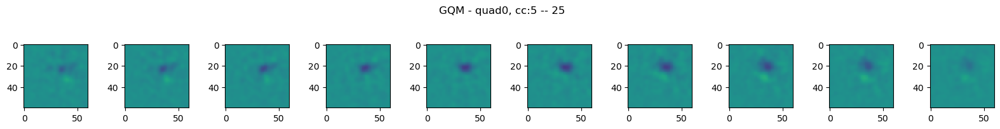

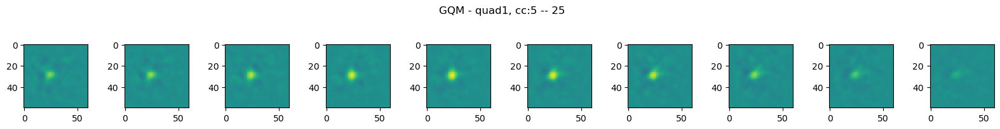

-------------


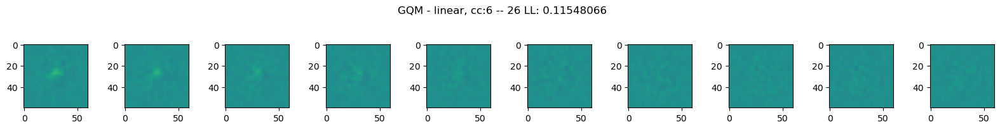

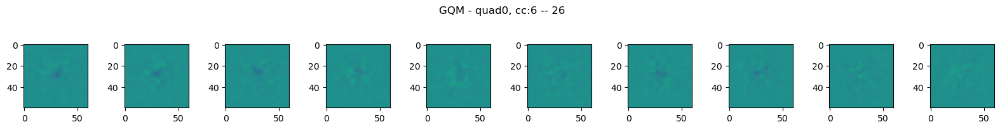

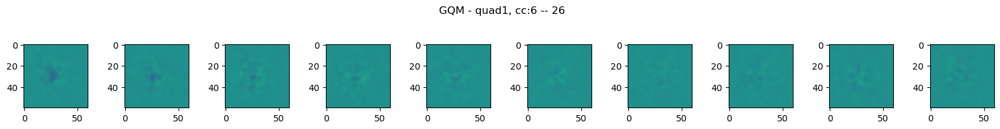

-------------


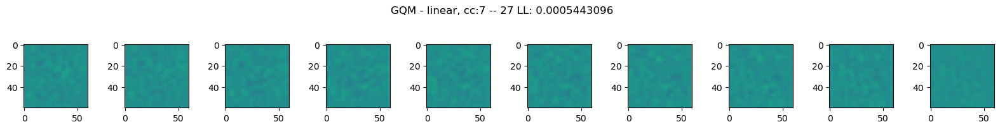

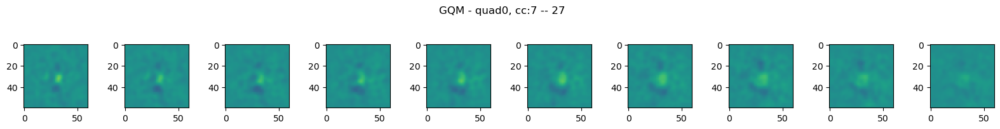

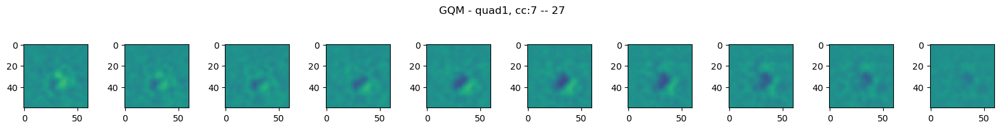

-------------


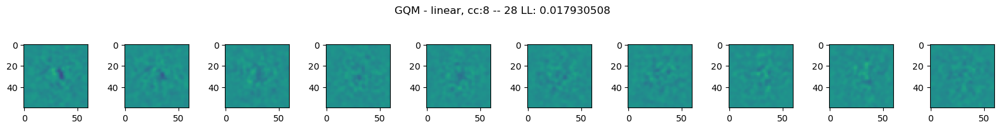

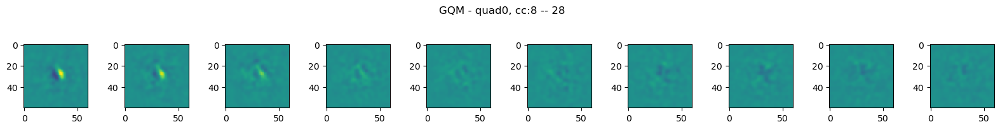

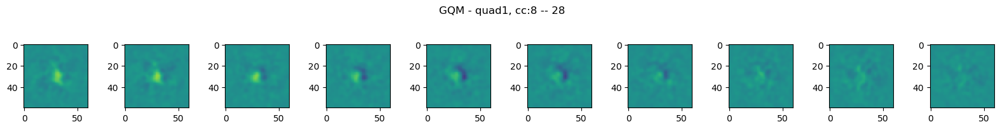

-------------


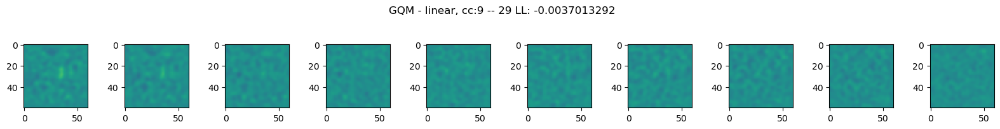

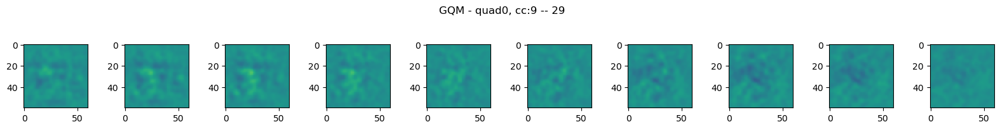

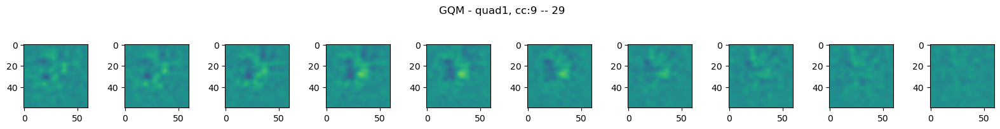

-------------


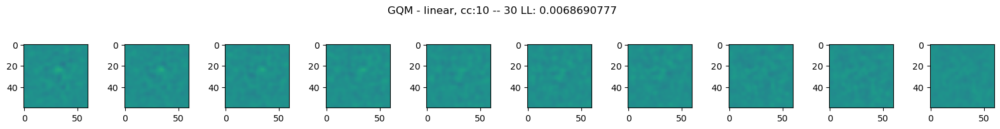

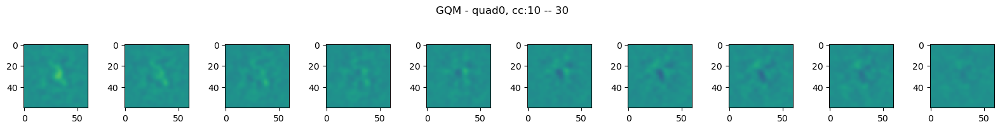

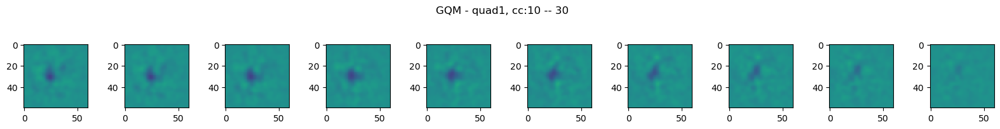

-------------


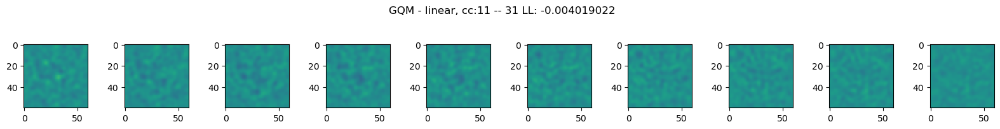

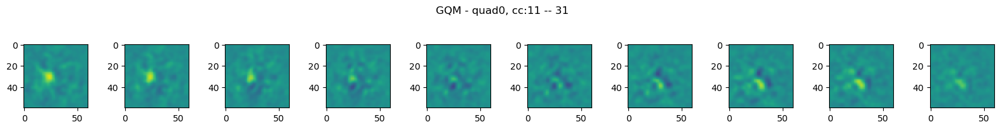

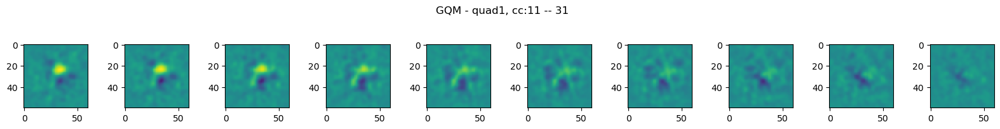

-------------


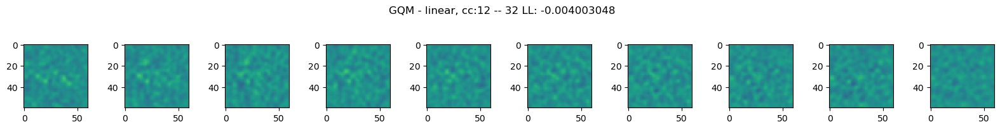

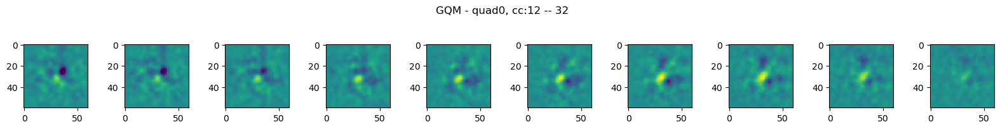

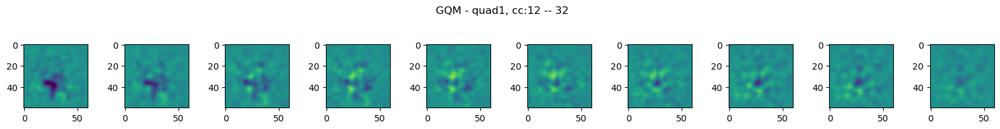

-------------


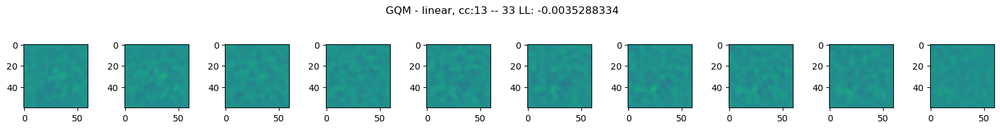

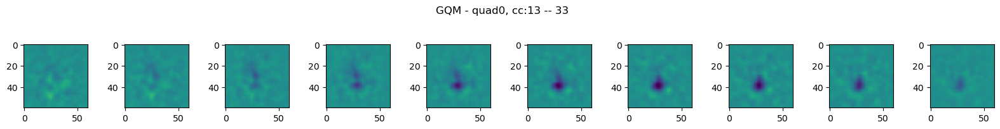

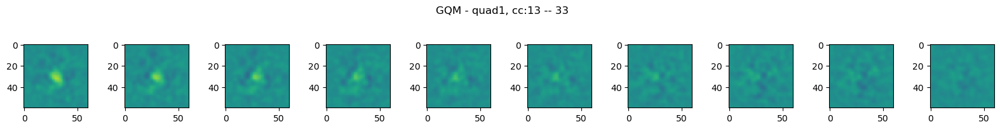

-------------


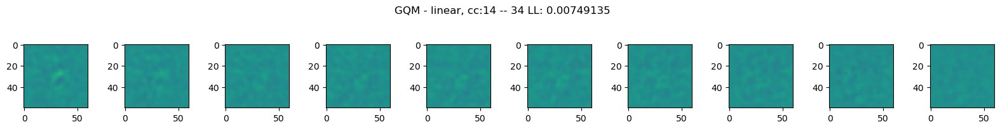

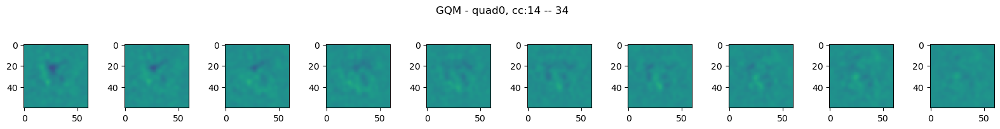

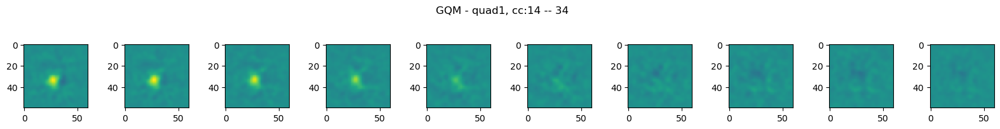

-------------


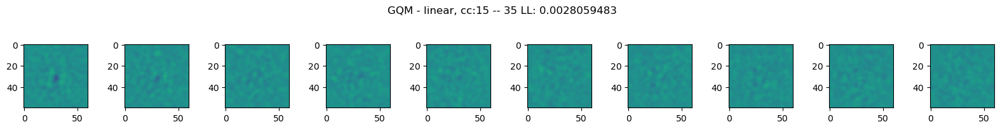

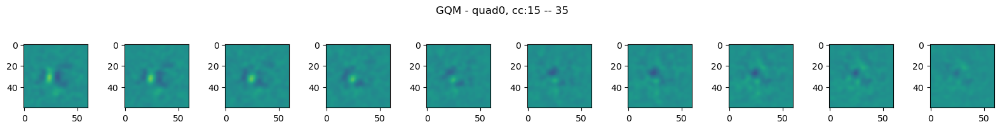

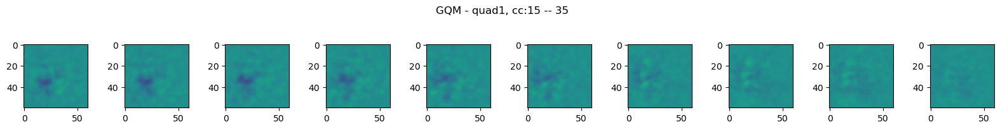

-------------


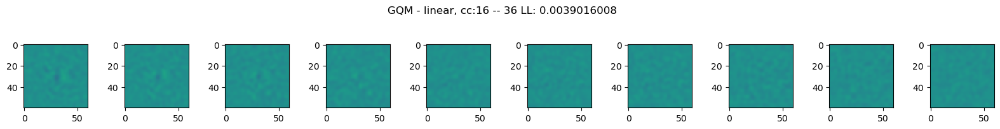

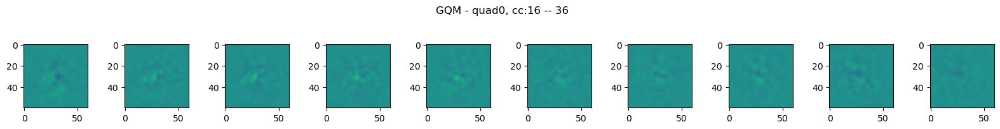

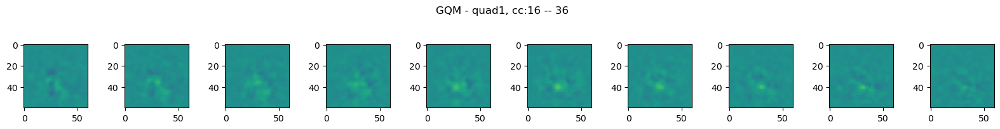

-------------


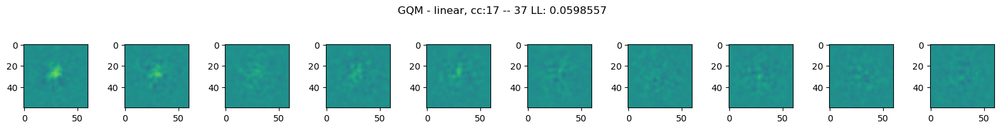

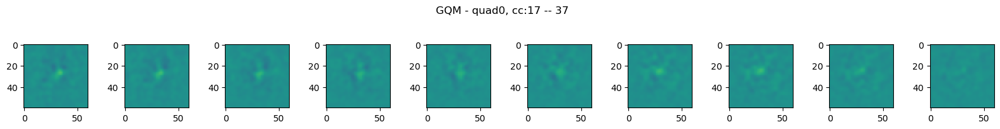

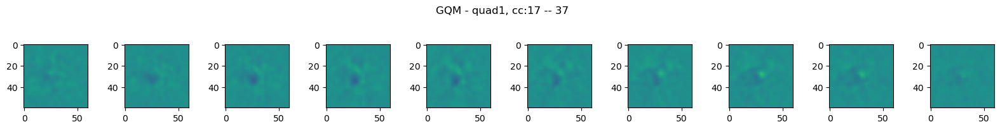

-------------


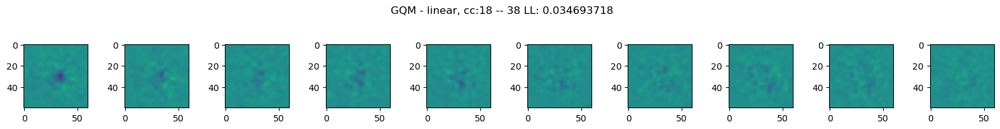

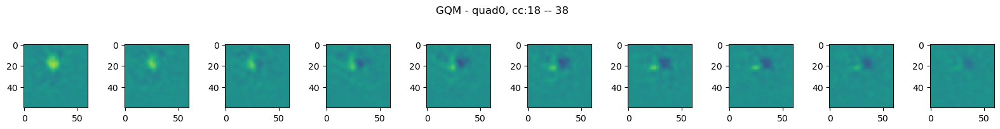

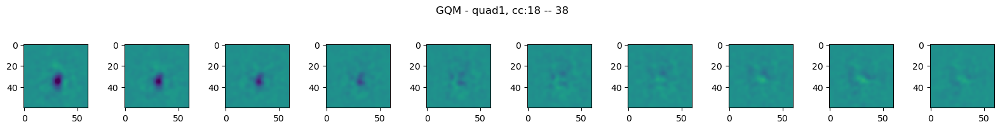

-------------


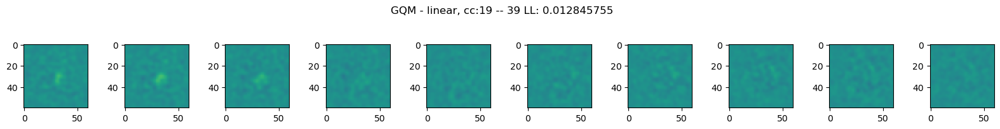

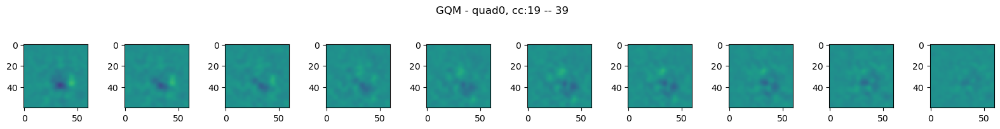

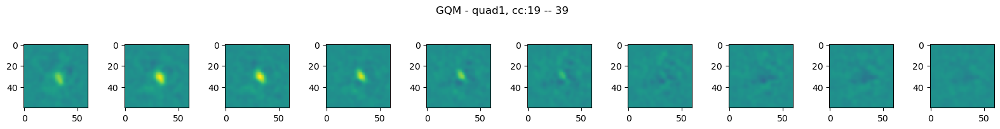

-------------


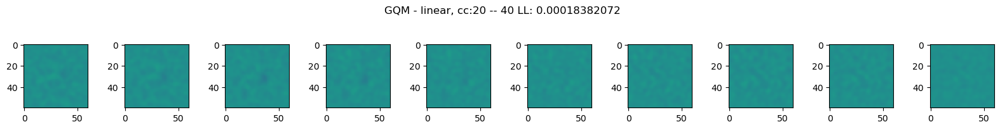

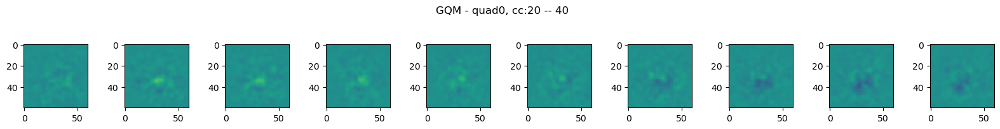

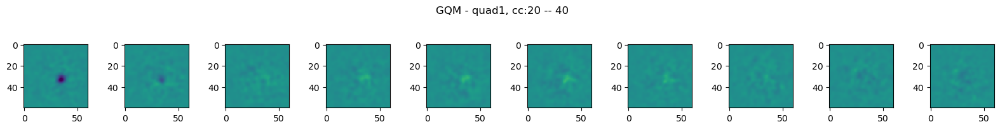

-------------


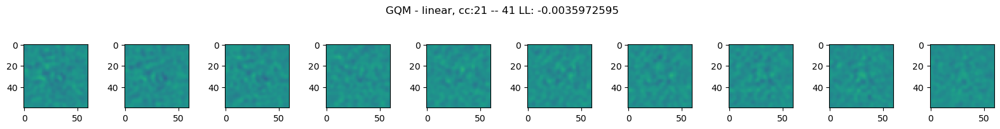

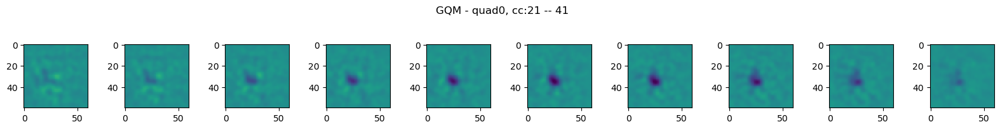

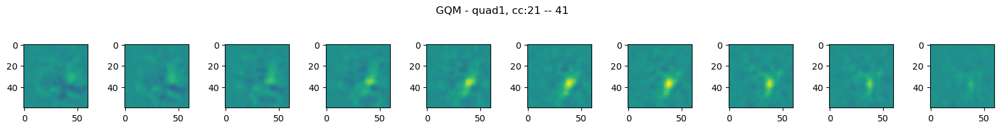

-------------


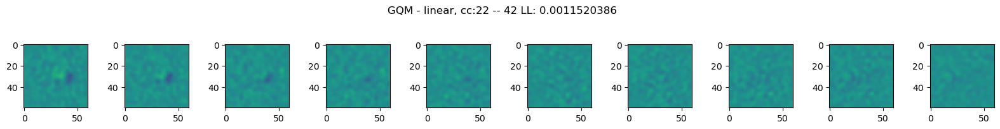

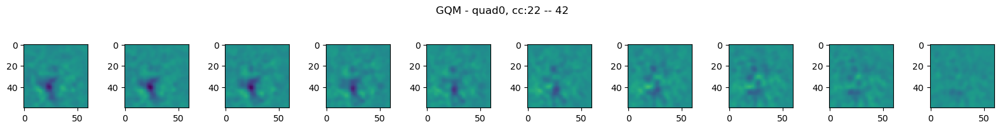

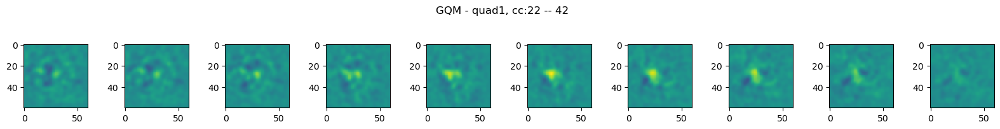

-------------


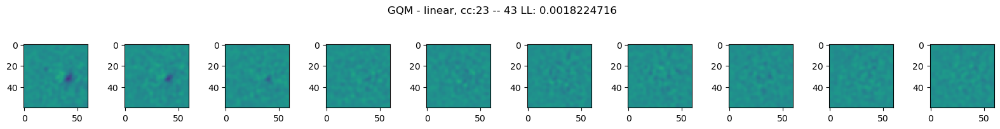

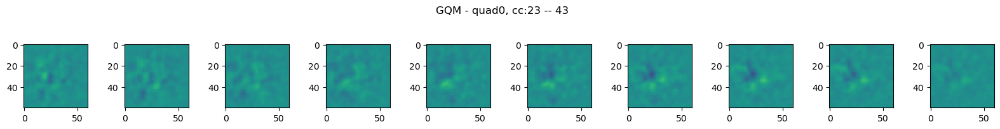

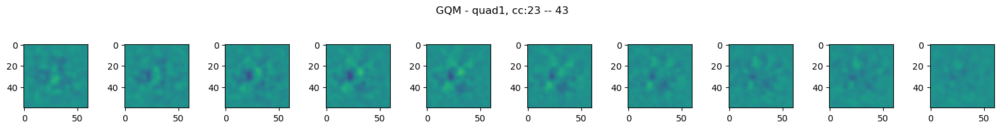

-------------


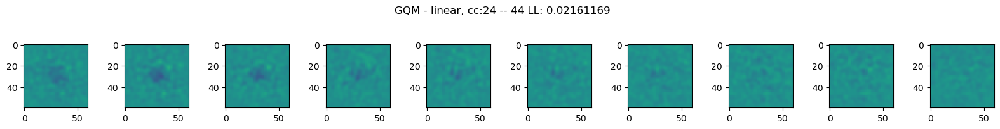

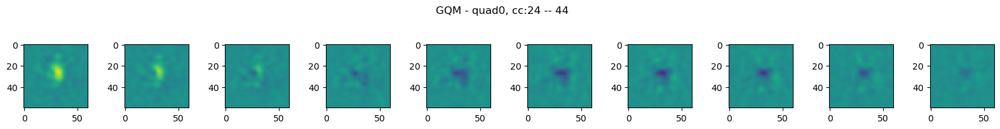

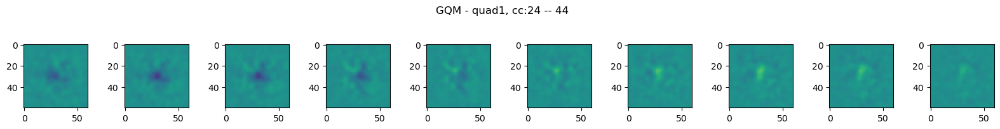

-------------


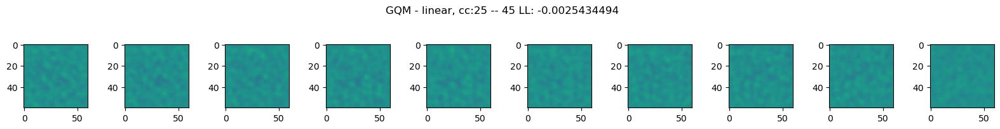

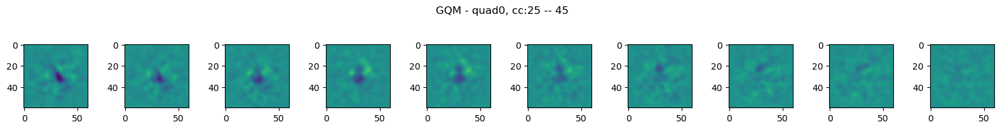

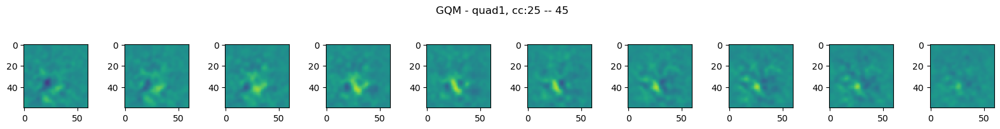

-------------


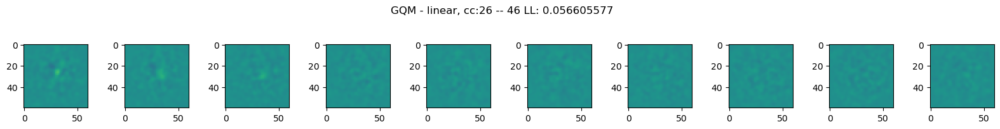

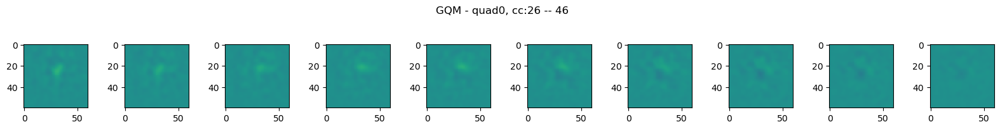

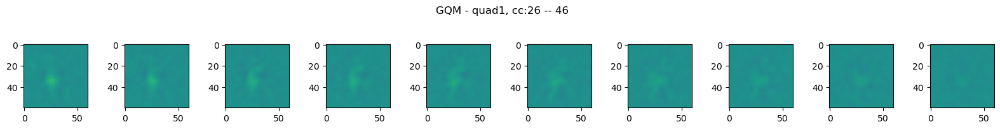

-------------


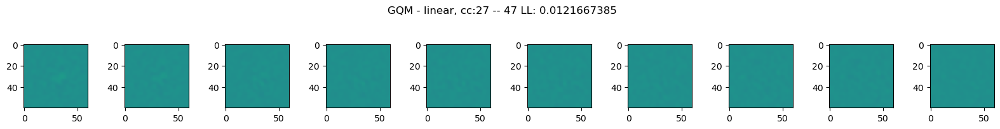

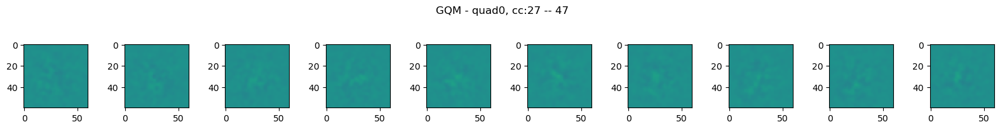

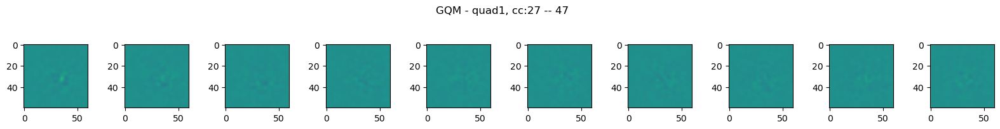

-------------


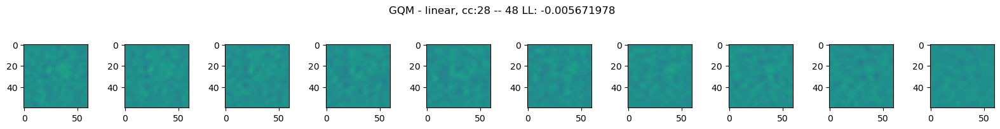

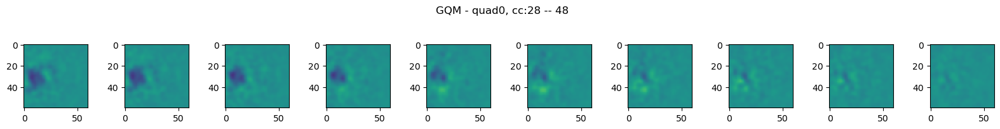

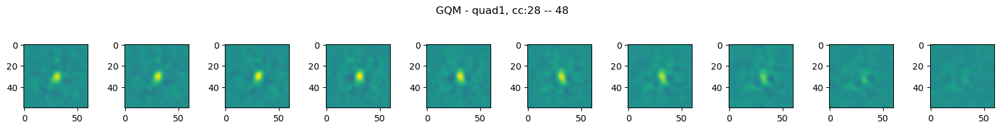

-------------


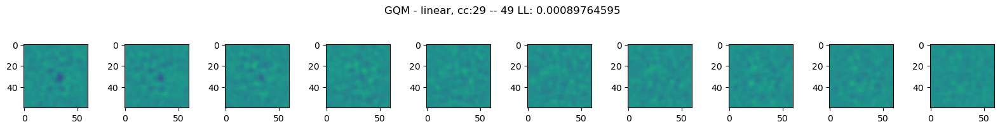

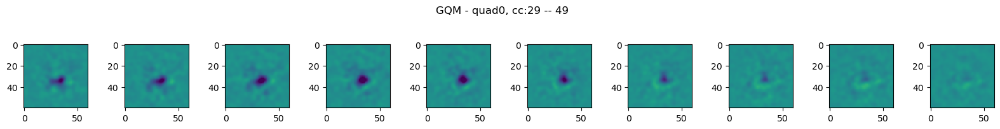

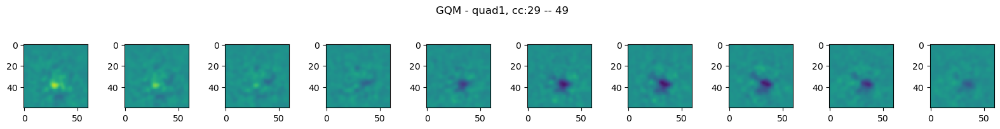

-------------


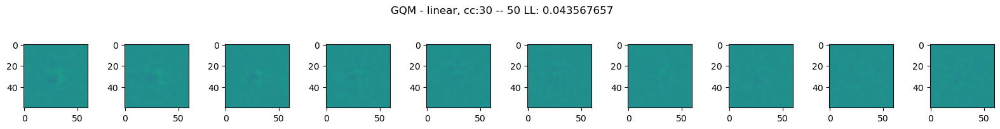

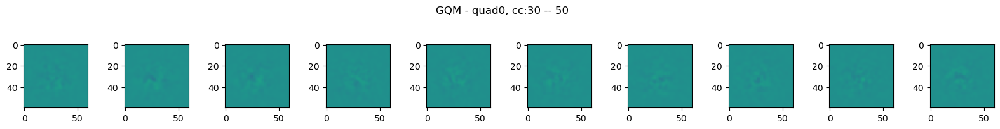

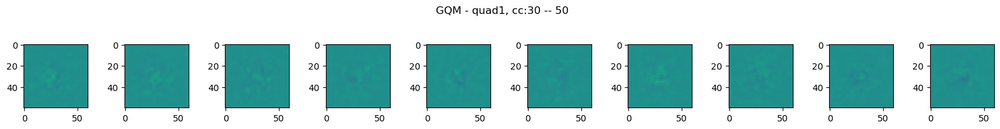

-------------


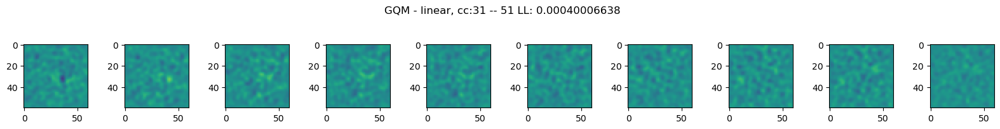

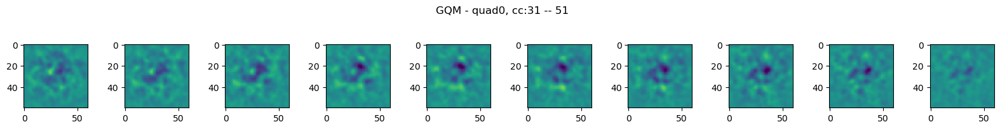

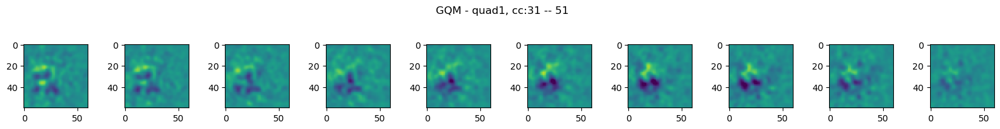

-------------


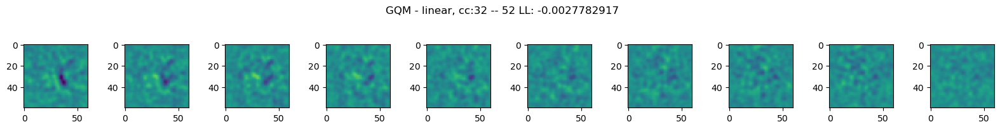

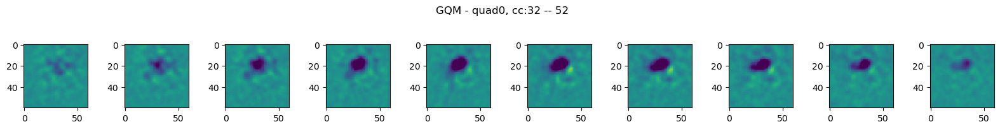

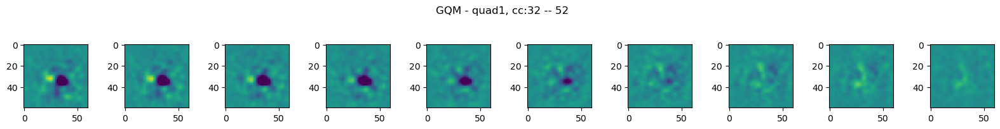

-------------


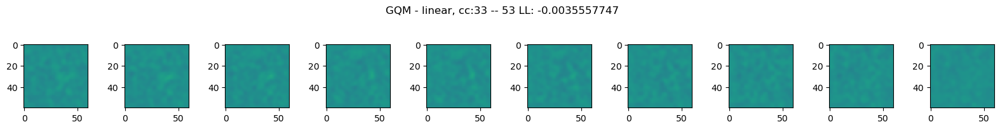

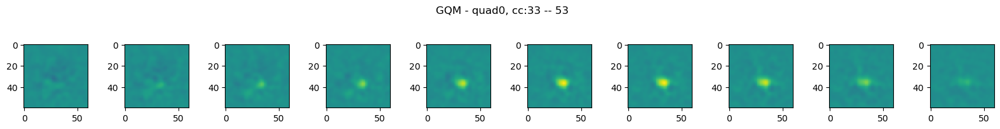

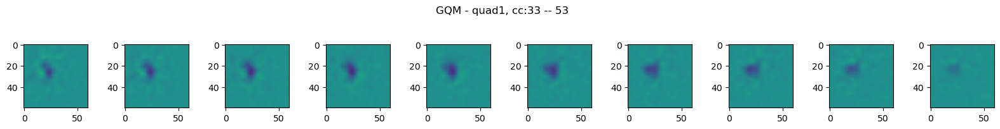

-------------


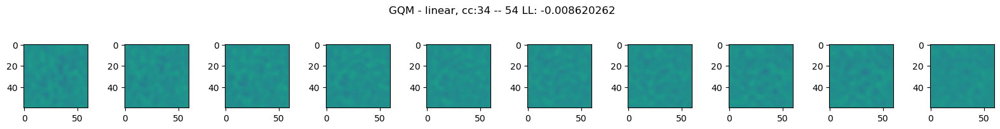

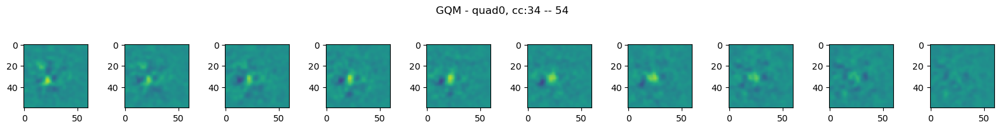

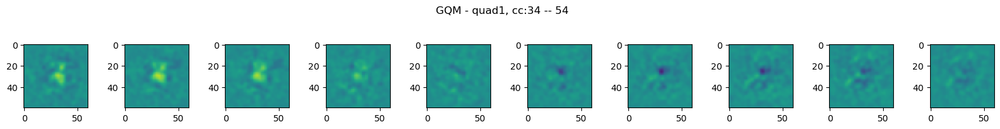

-------------


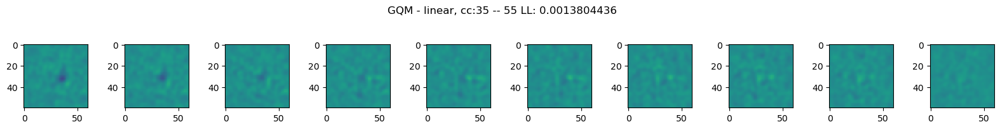

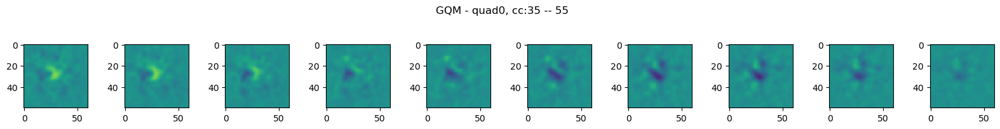

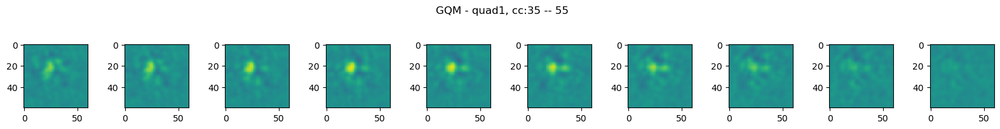

-------------


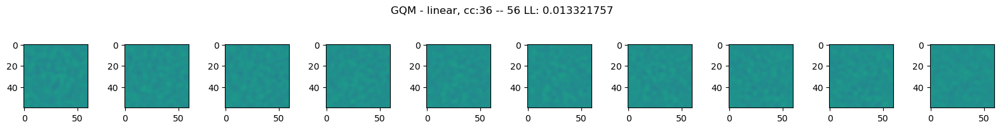

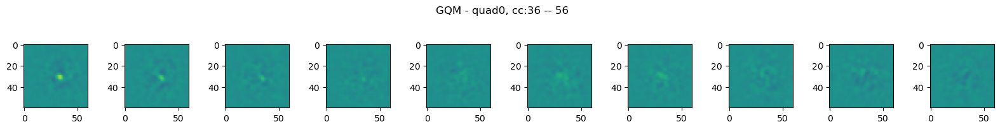

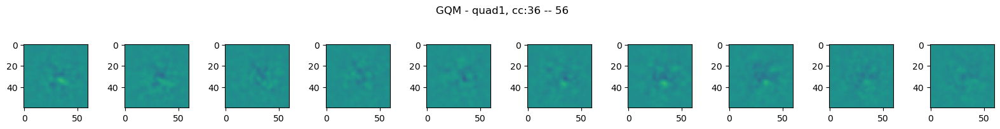

-------------


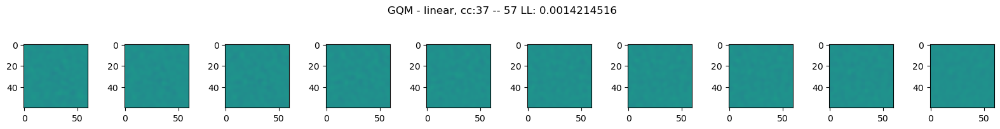

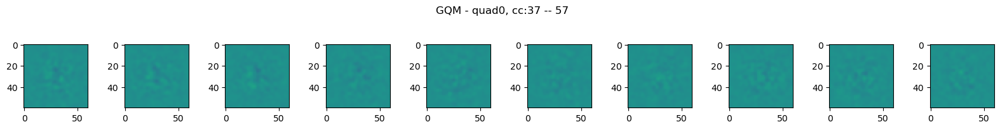

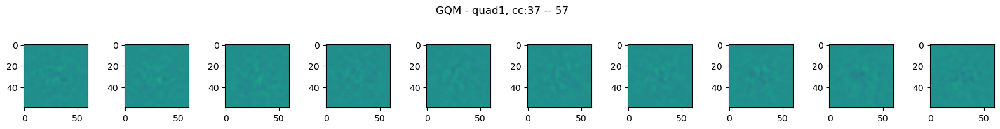

-------------


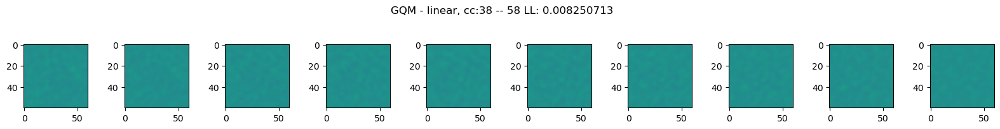

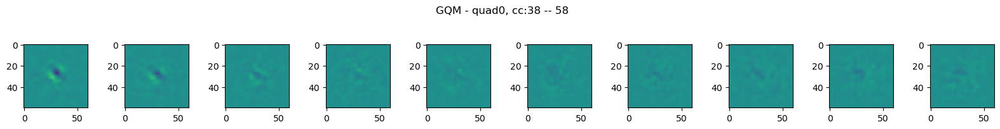

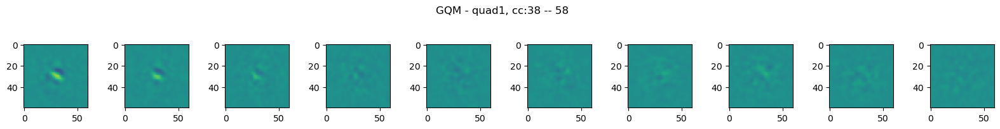

-------------


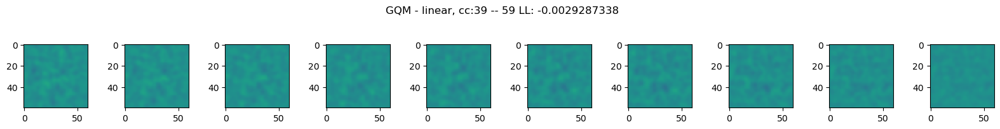

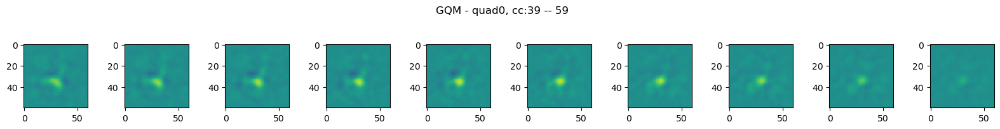

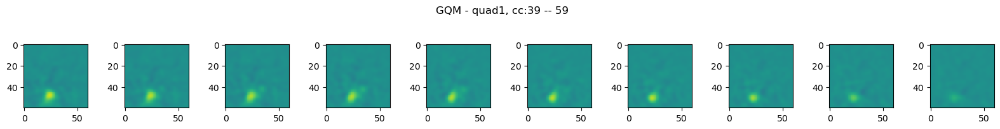

-------------


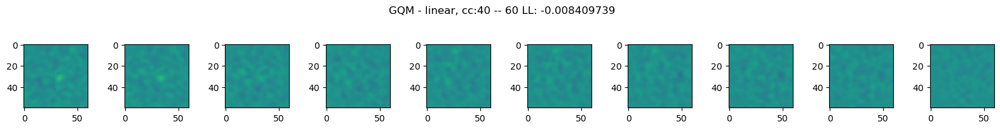

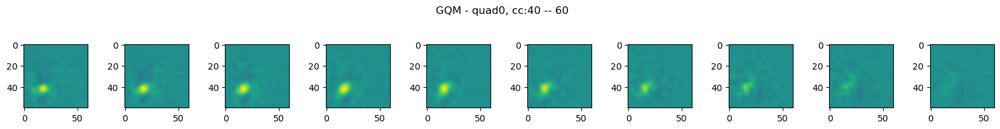

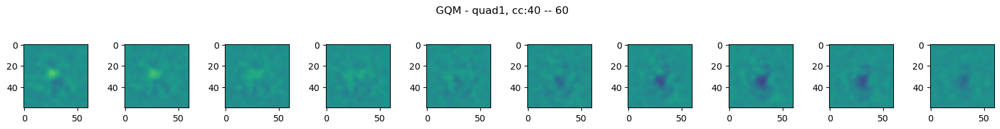

-------------


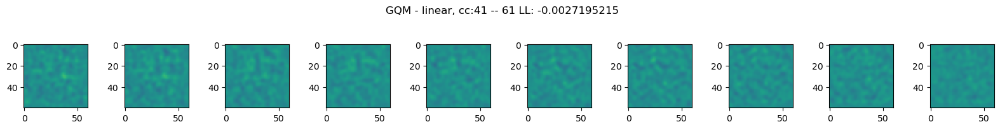

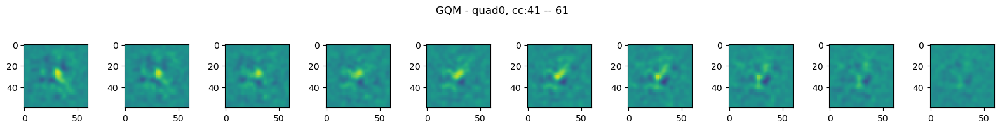

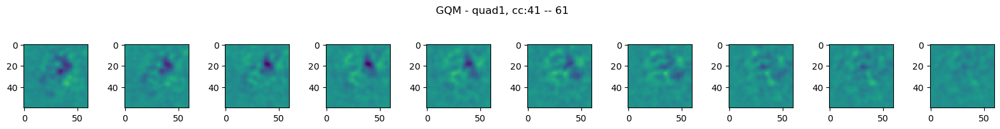

-------------


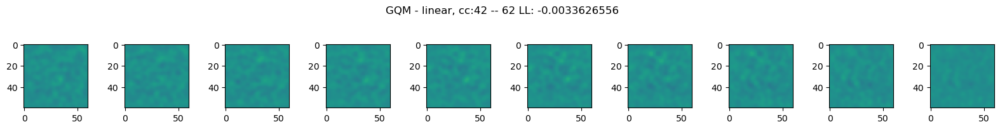

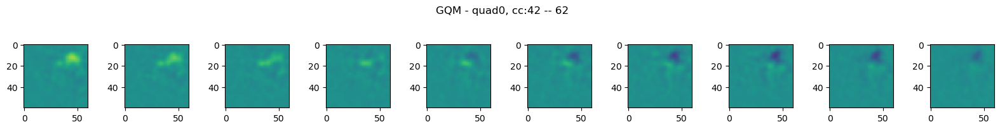

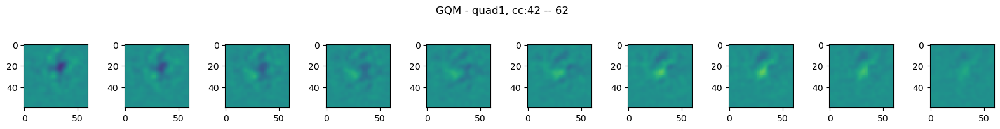

-------------


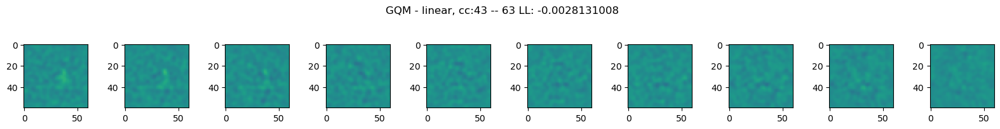

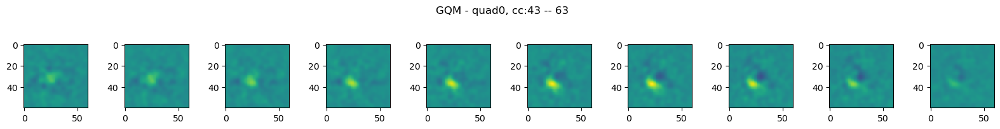

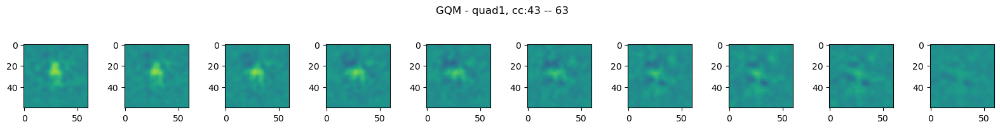

-------------


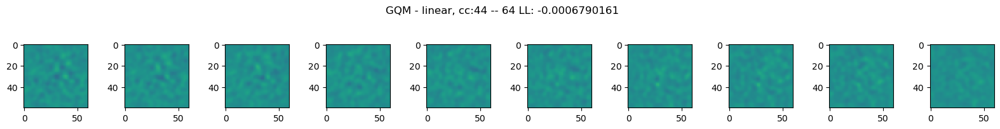

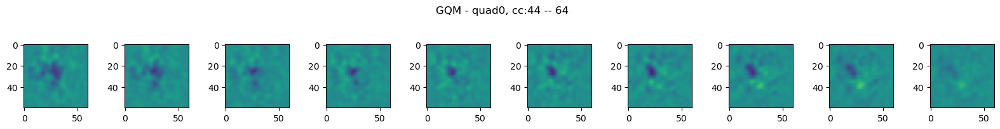

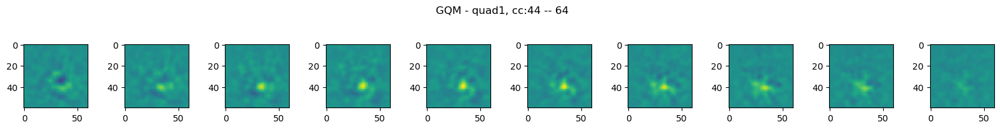

-------------


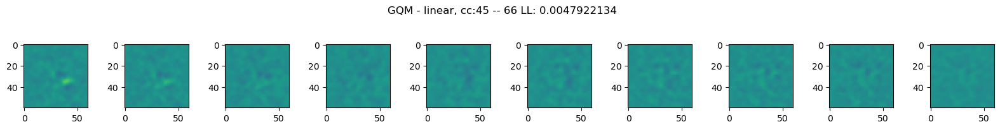

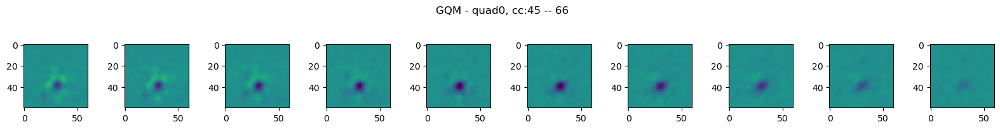

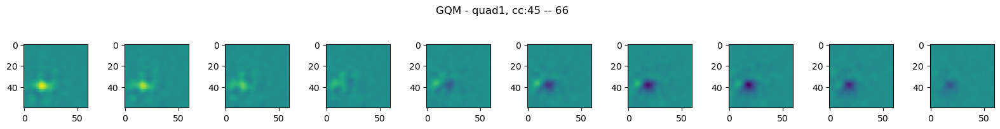

-------------


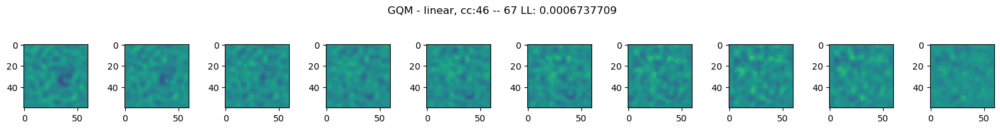

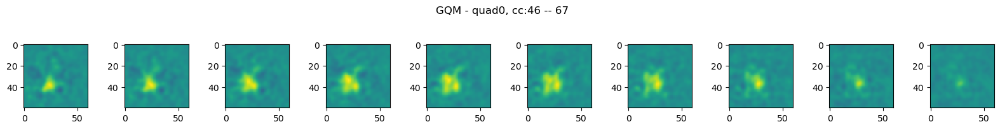

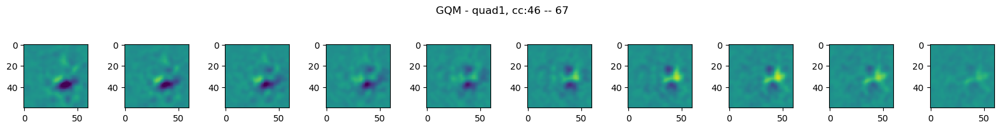

-------------


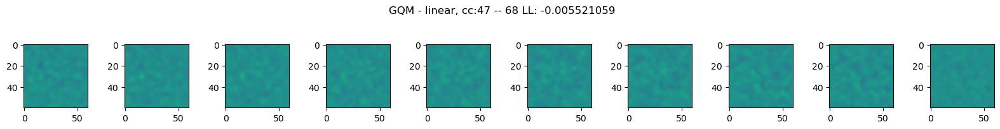

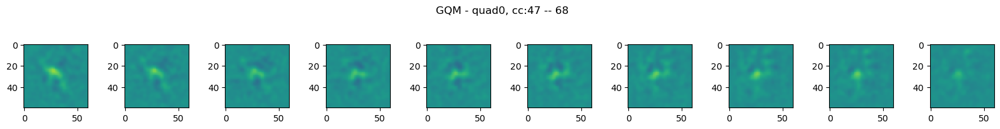

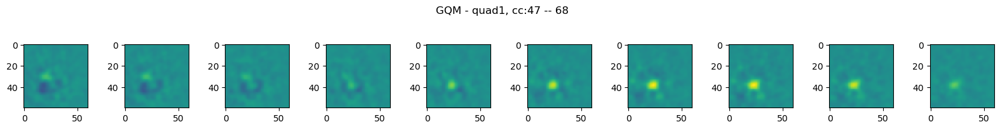

-------------


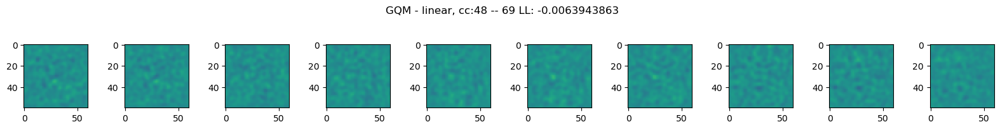

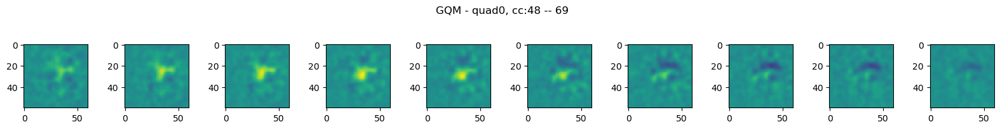

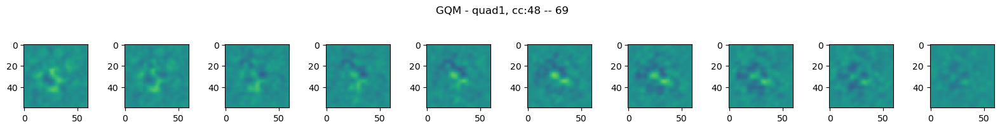

-------------


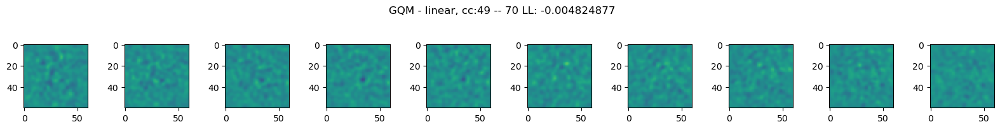

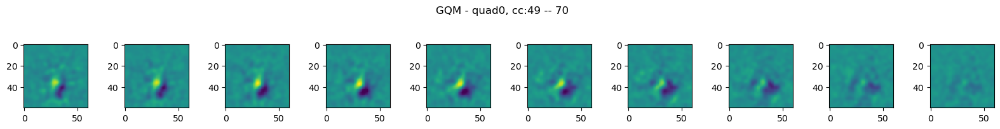

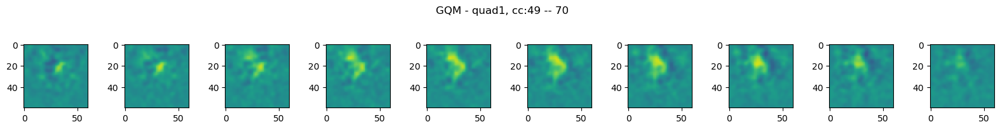

-------------


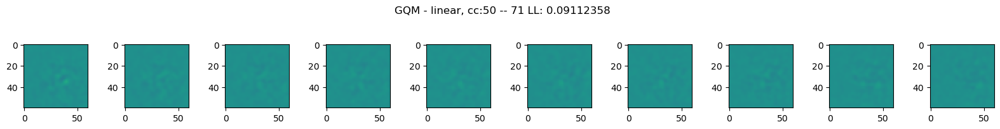

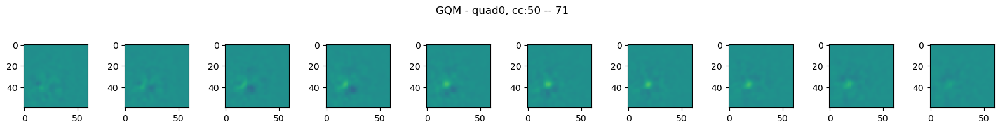

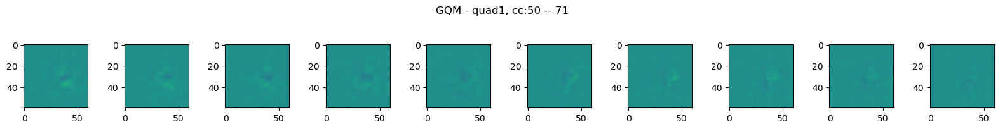

-------------


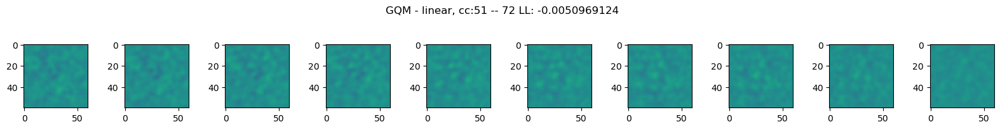

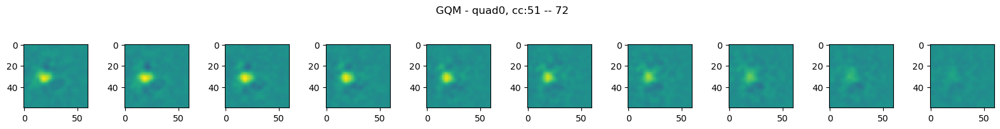

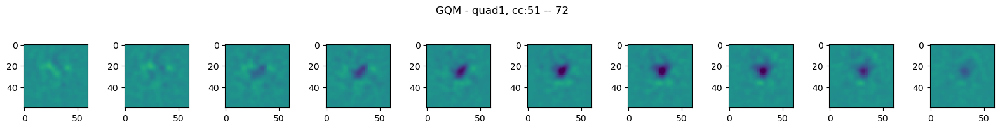

-------------


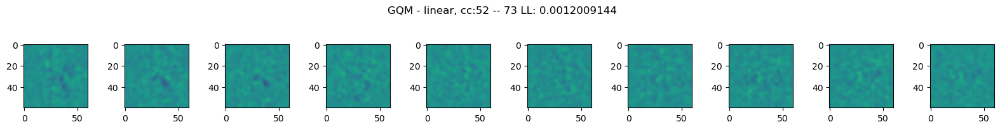

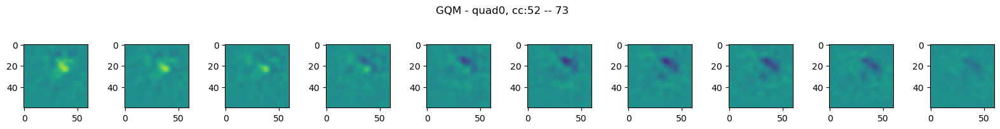

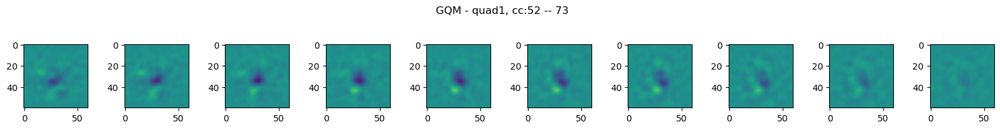

-------------


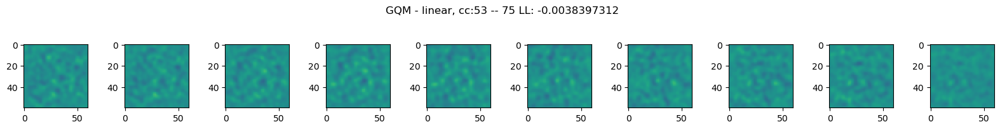

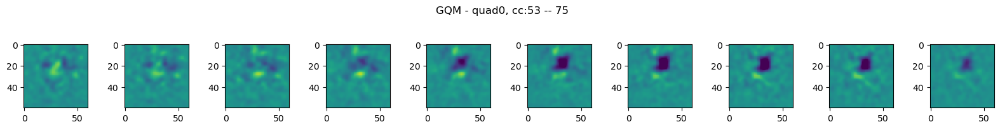

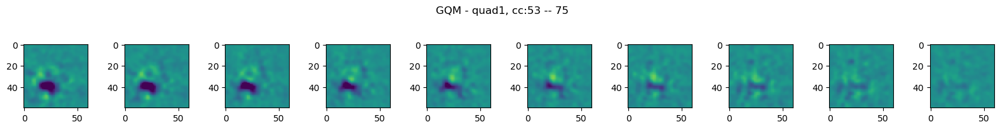

-------------


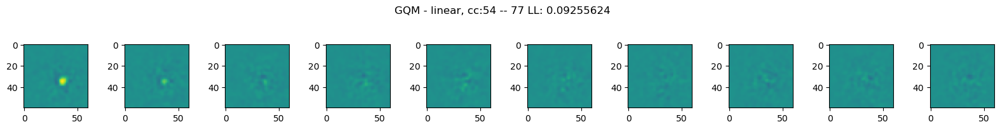

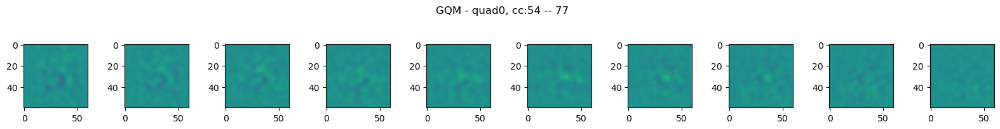

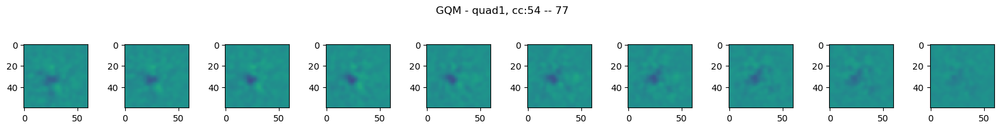

-------------


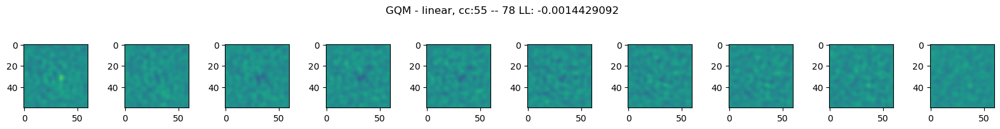

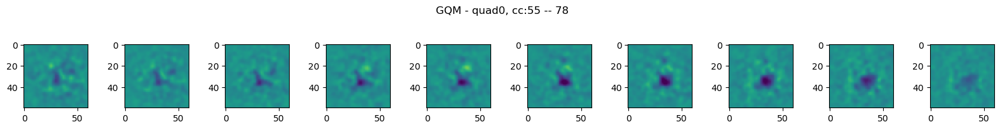

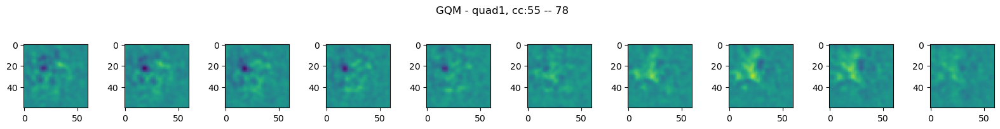

-------------


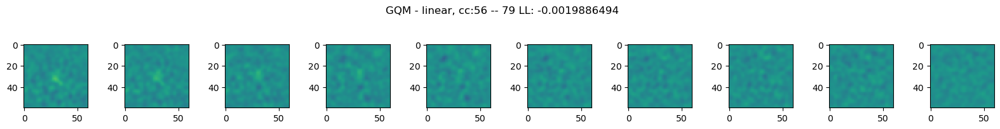

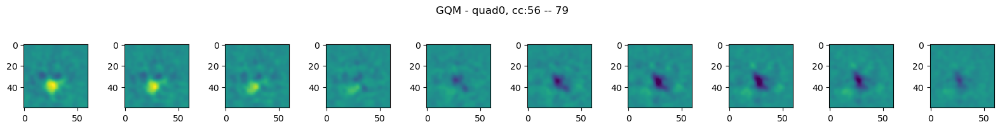

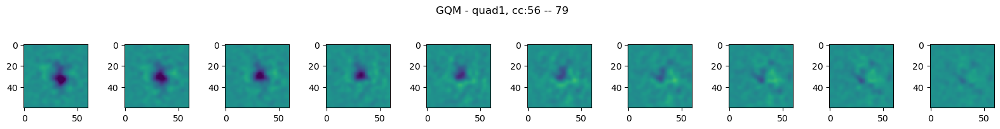

-------------


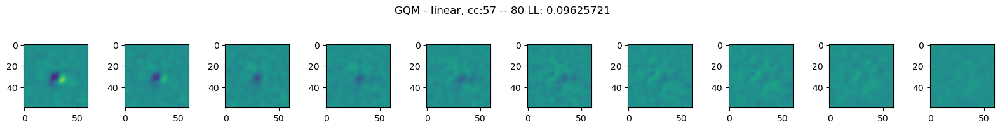

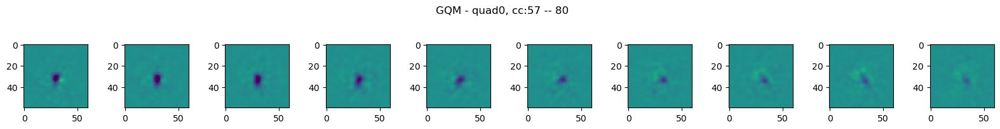

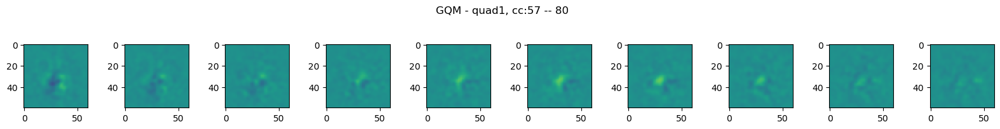

-------------


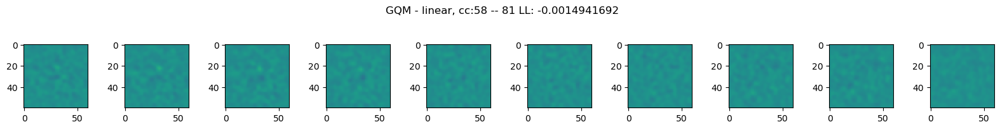

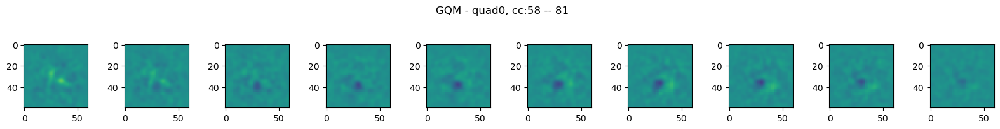

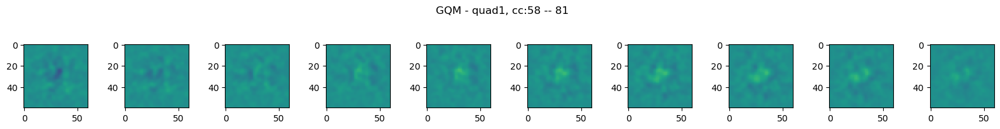

-------------


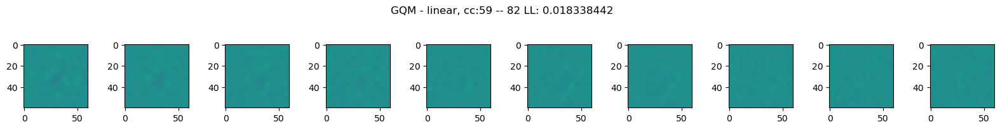

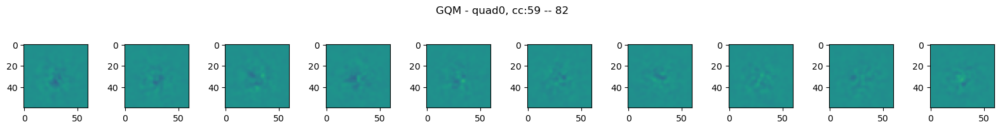

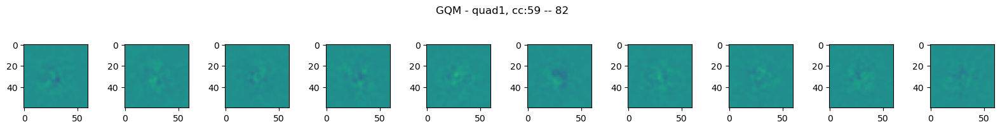

-------------


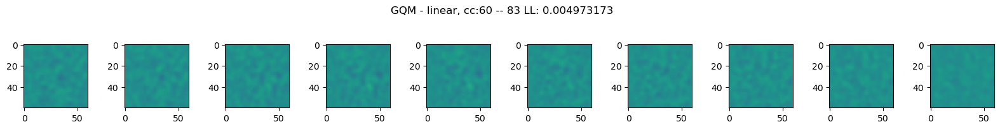

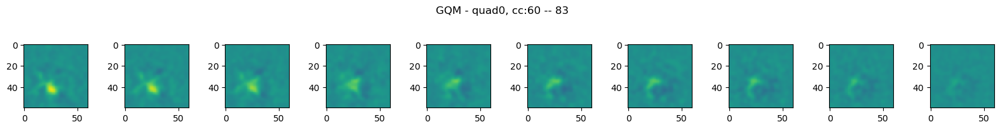

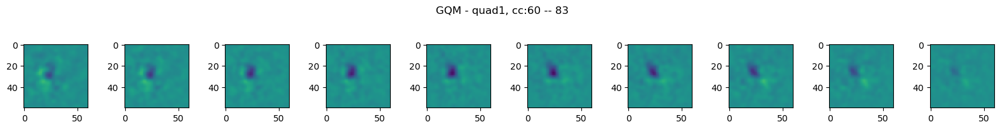

-------------


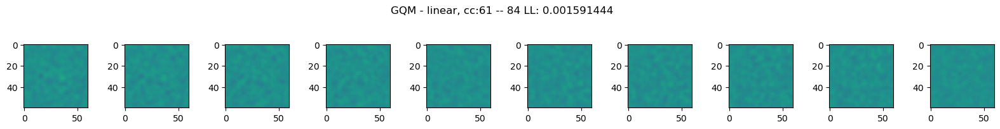

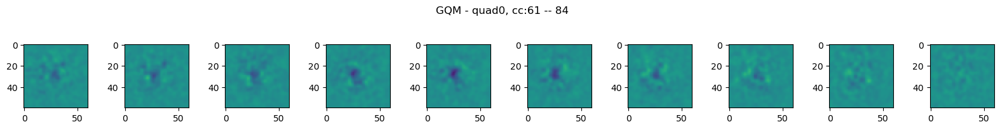

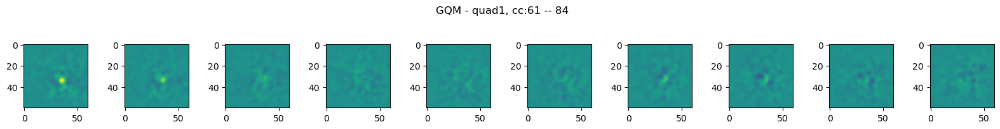

-------------


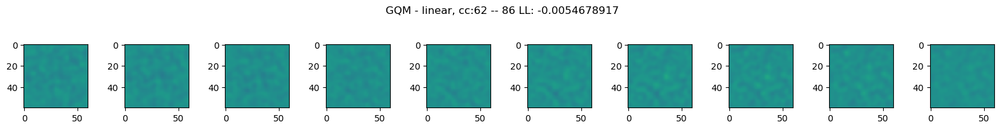

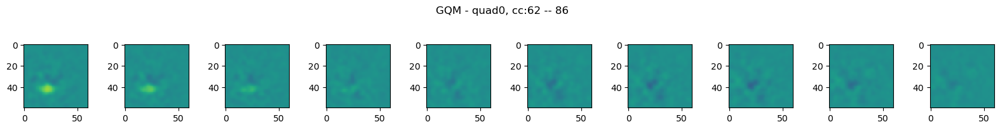

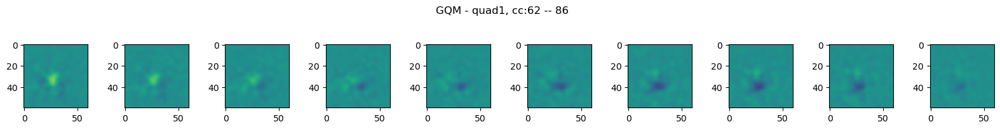

-------------


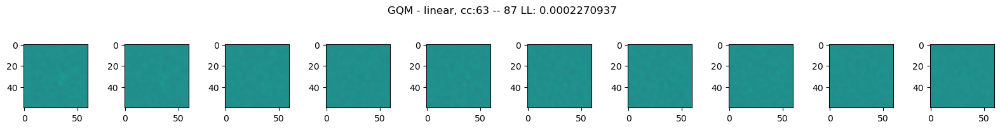

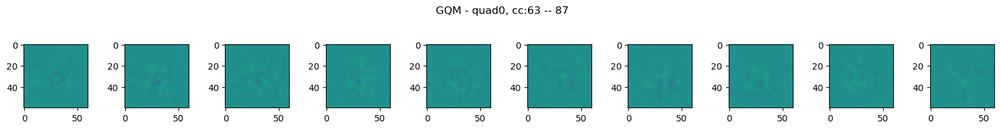

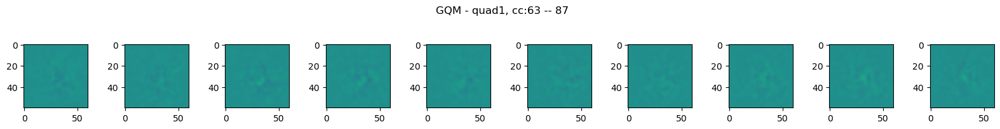

-------------


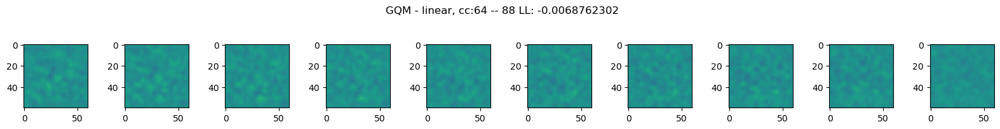

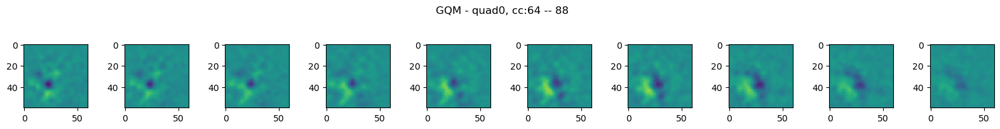

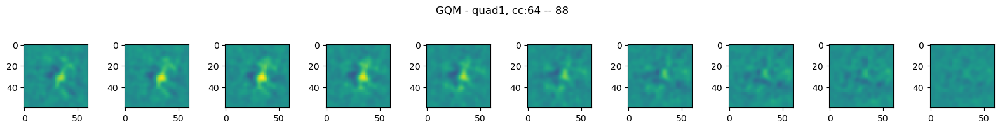

-------------


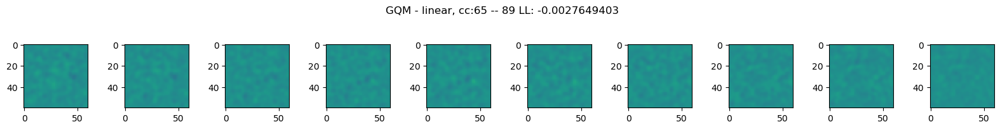

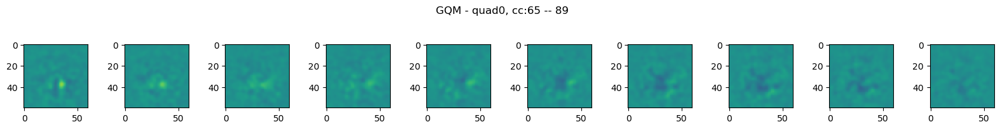

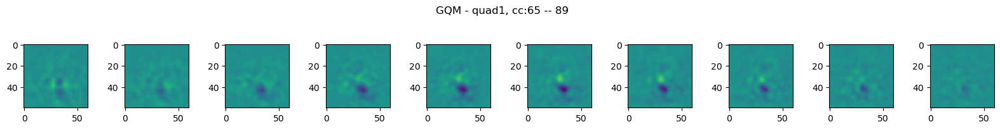

-------------


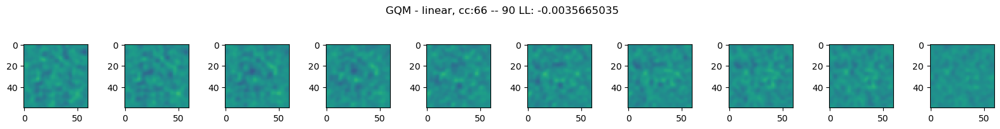

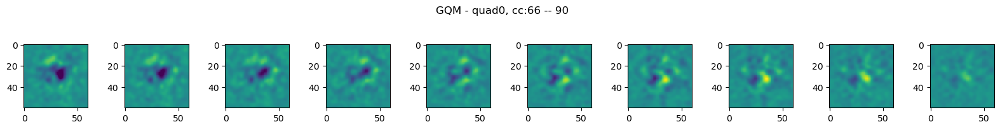

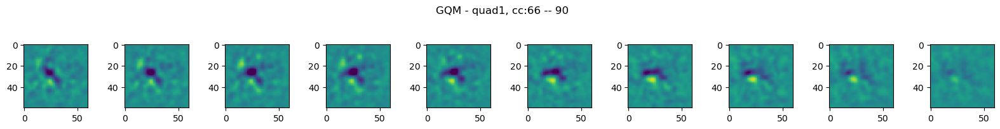

-------------


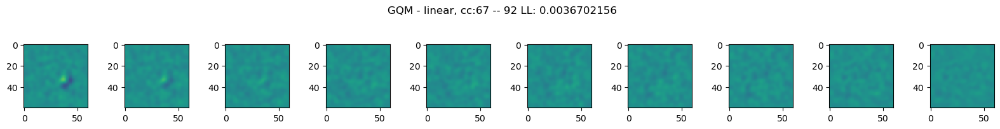

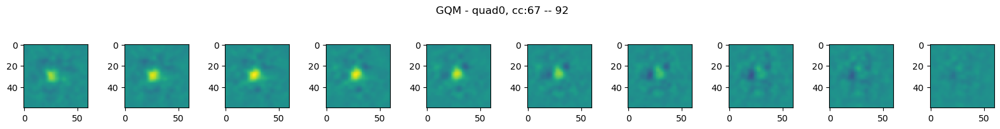

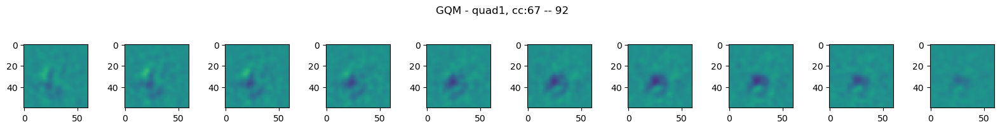

-------------


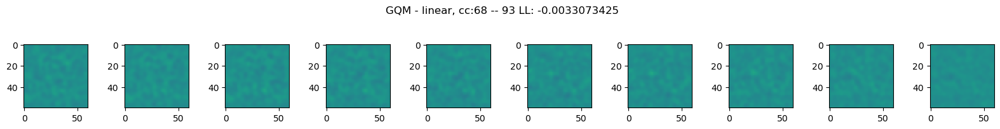

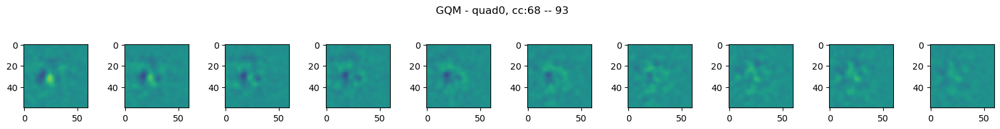

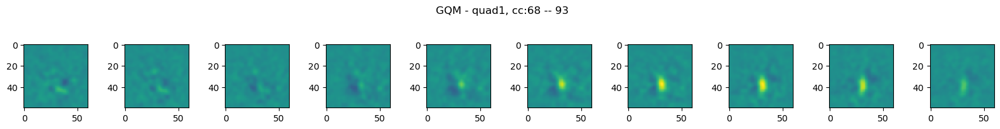

-------------


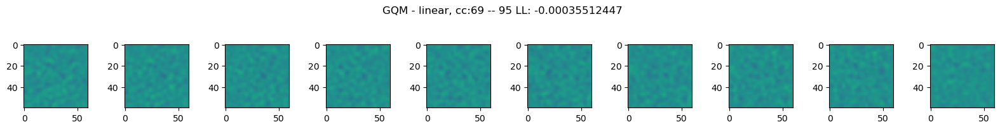

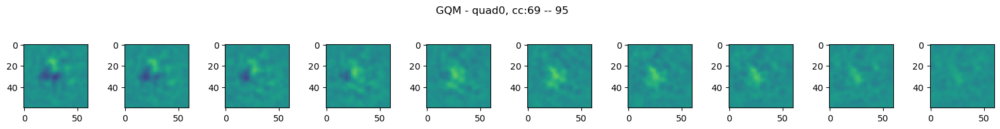

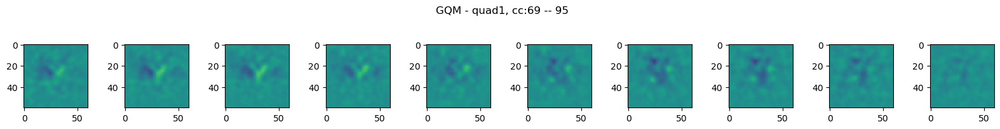

-------------


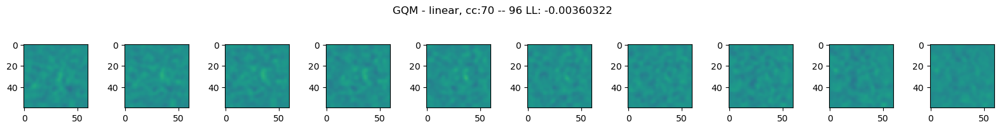

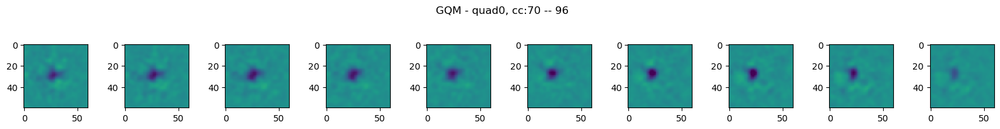

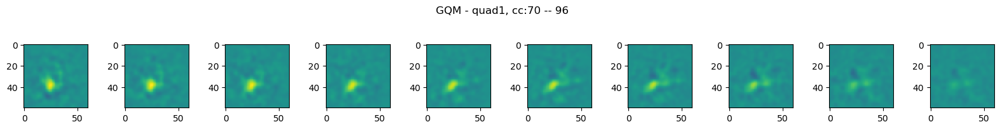

-------------


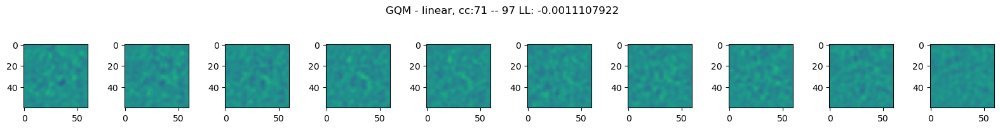

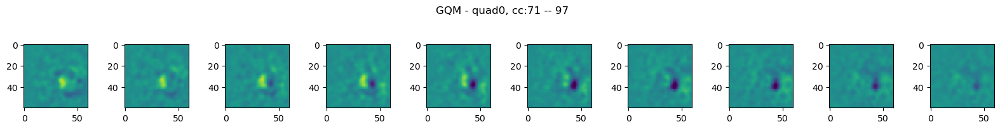

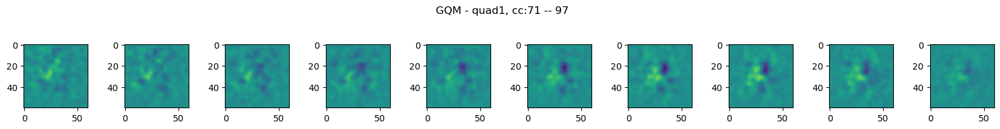

-------------


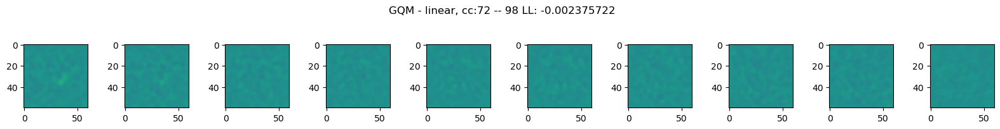

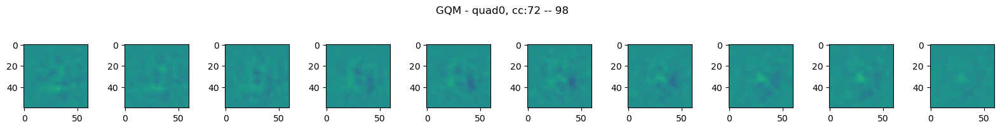

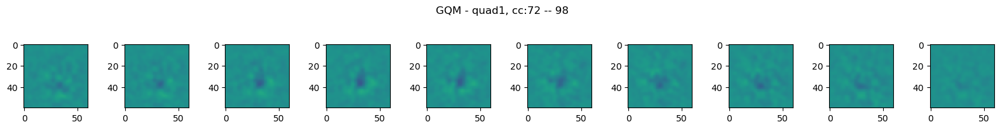

-------------


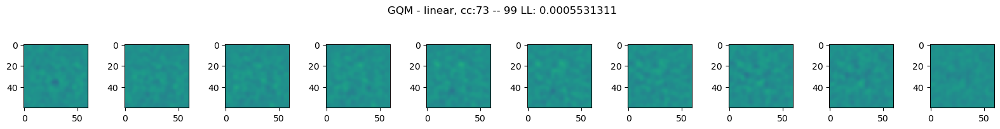

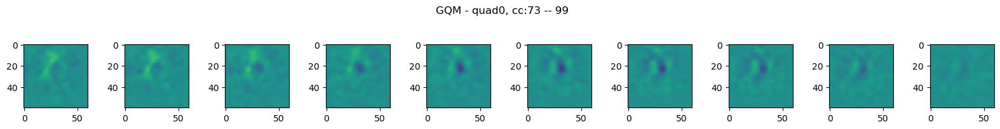

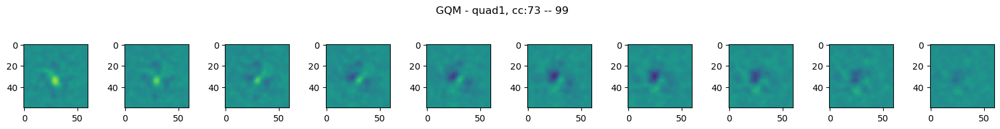

-------------


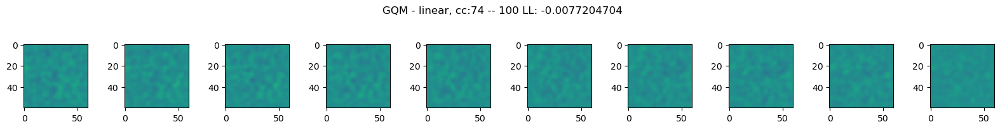

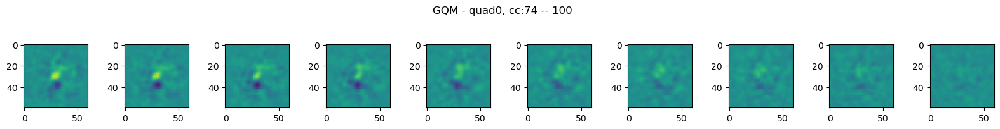

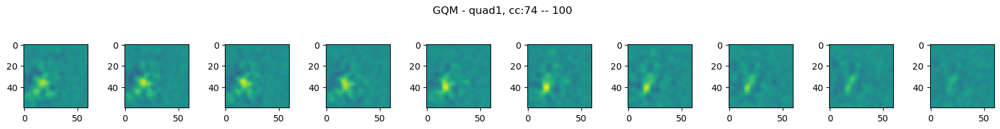

-------------


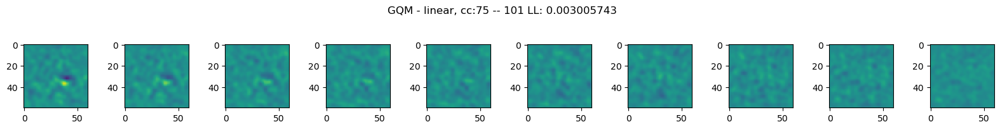

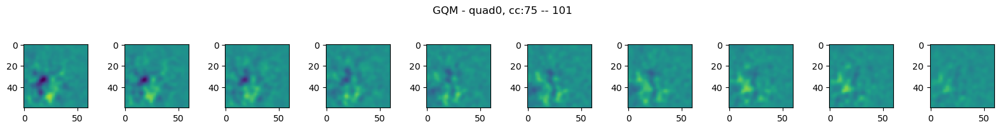

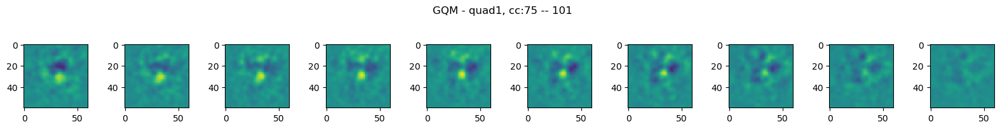

-------------


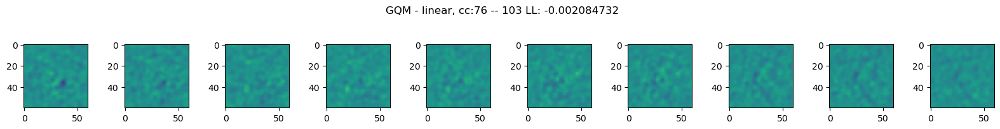

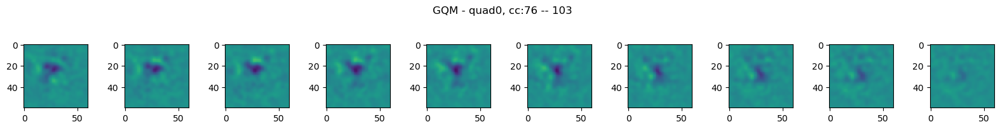

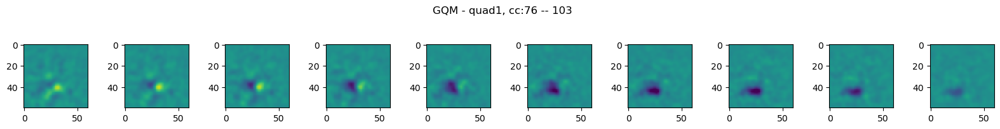

-------------


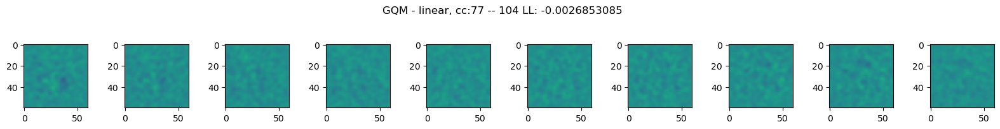

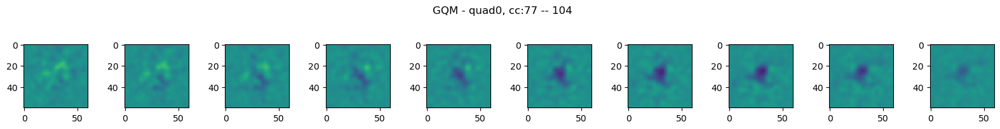

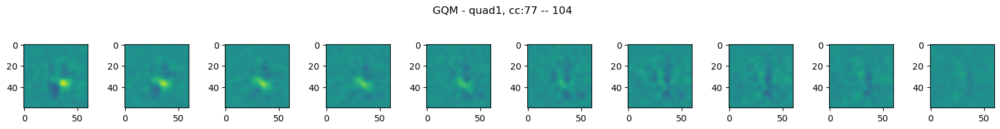

-------------


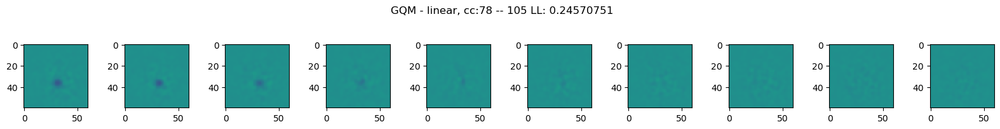

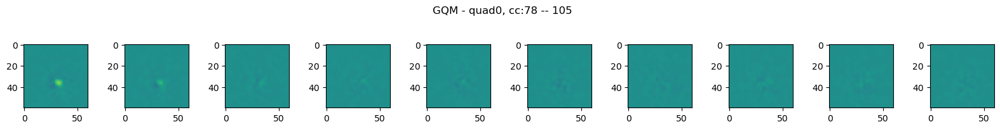

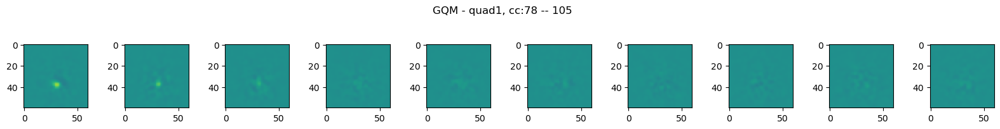

-------------


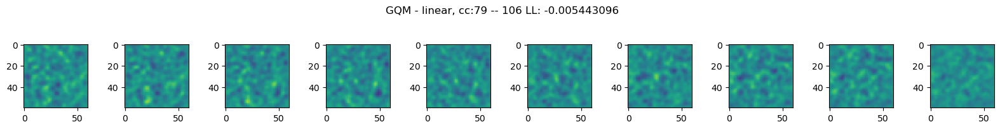

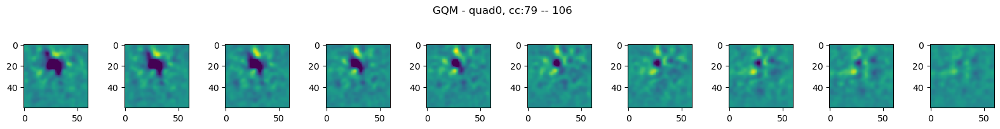

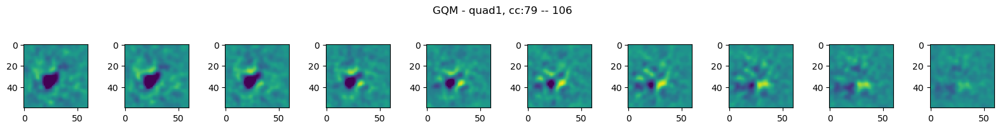

-------------


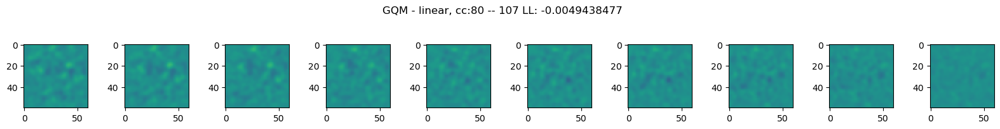

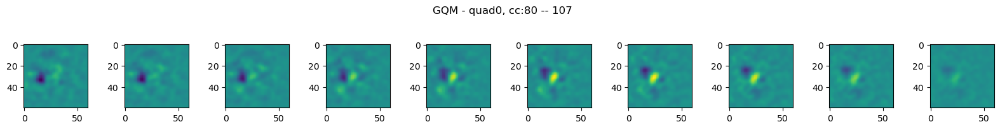

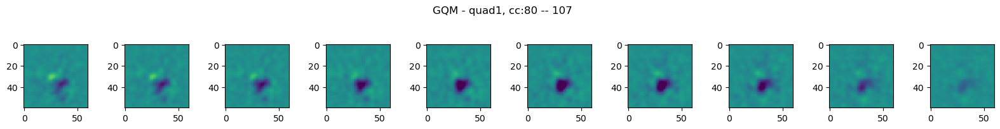

-------------


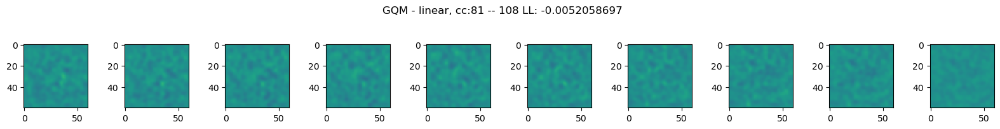

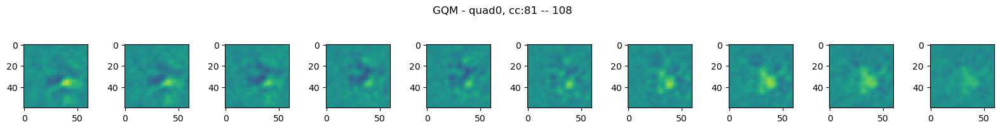

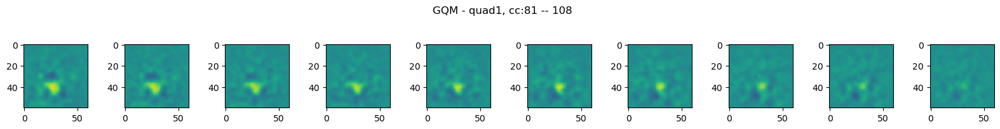

-------------


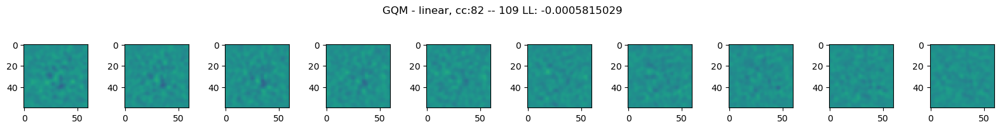

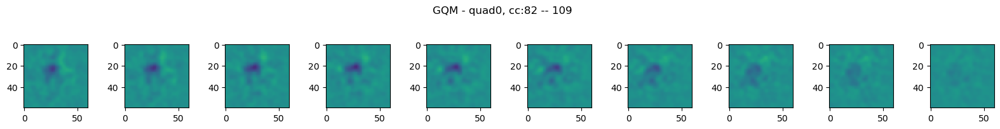

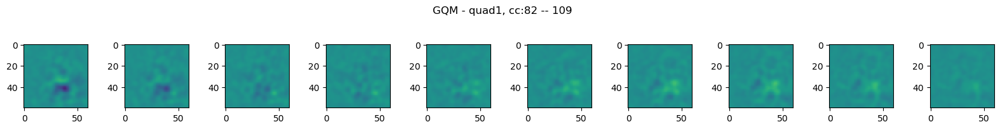

-------------


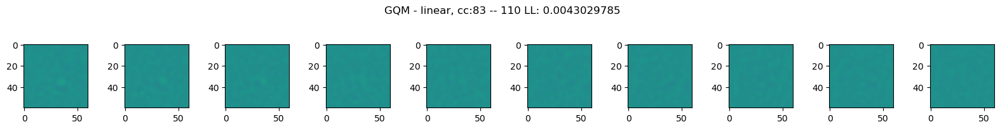

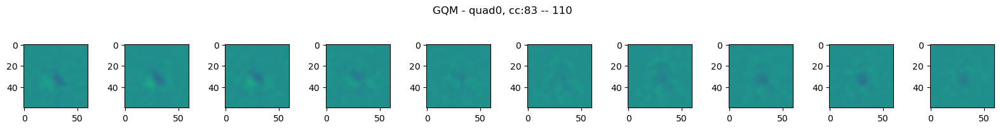

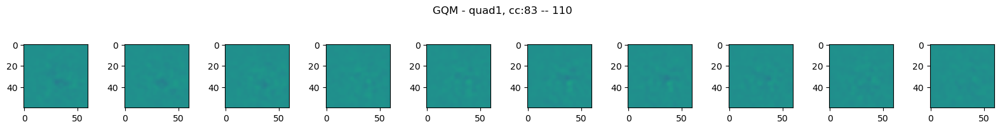

In [13]:
for i in range(84):
    max_weights = 0
    weights_lin = np.max(gqms[i].ndn_model.networks[0].layers[0].get_weights())
    weights_quad = np.max(gqms[i].ndn_model.networks[2].layers[0].get_weights())
    if weights_lin > max_weights:
        max_weights = weights_lin
    if weights_quad > max_weights:
        max_weights = weights_quad
        
    print('-------------')
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(gqms[i].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - linear, cc:' + str(i) + ' -- ' + str(valET[i]) + ' LL: ' + str(gqms[i].LLs))
        col += 1
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(gqms[i].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - quad0, cc:' + str(i) + ' -- ' + str(valET[i]))
        col += 1
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(gqms[i].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 1], max=max_weights)
        plt.suptitle('GQM - quad1, cc:' + str(i) + ' -- ' + str(valET[i]))
        col += 1
    plt.show()

## plot cross-sections
   of direction selective cells

(60, 60, 10) (60, 60, 10) (60, 60, 10)
-------------


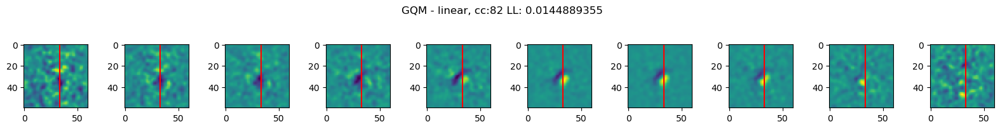

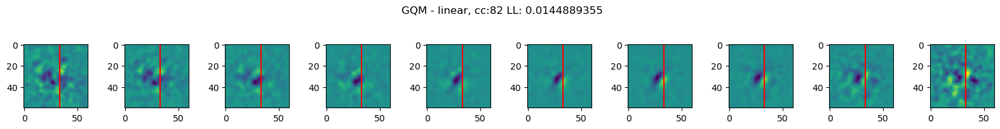

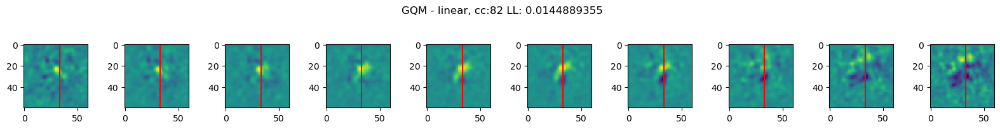

In [25]:
# start with cell 21 (looks like a direction selective cell)
linear = gqms[-1].ndn_model.networks[0].layers[0].get_weights()[:,:, :, 0]
quad0 = gqms[-1].ndn_model.networks[2].layers[0].get_weights()[:,:, :, 0]
quad1 = gqms[-1].ndn_model.networks[2].layers[0].get_weights()[:,:, :, 1]
print(linear.shape, quad0.shape, quad1.shape)

print('-------------')
ss(1,10)
for lag in range(10):
    plt.subplot(1,10, lag+1)
    imagesc(gqms[-1].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0])
    # draw a vertical line at the center of the image
    plt.axvline(x=33, color='r')
    plt.suptitle('GQM - linear, cc:' + str(valET[interesting_cells[-1]]) + ' LL: ' + str(gqms[-1].LLs))
ss(1,10)
for lag in range(10):
    plt.subplot(1,10, lag+1)
    imagesc(gqms[-1].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 0])
    plt.suptitle('GQM - quad0, cc:' + str(valET[interesting_cells[-1]]))
    plt.axvline(x=33, color='r')
ss(1,10)
for lag in range(10):
    plt.subplot(1,10, lag+1)
    imagesc(gqms[-1].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 1])
    plt.suptitle('GQM - quad1, cc:' + str(valET[interesting_cells[-1]]))
    plt.axvline(x=33, color='r')
plt.show()

Text(0, 0.5, 'time')

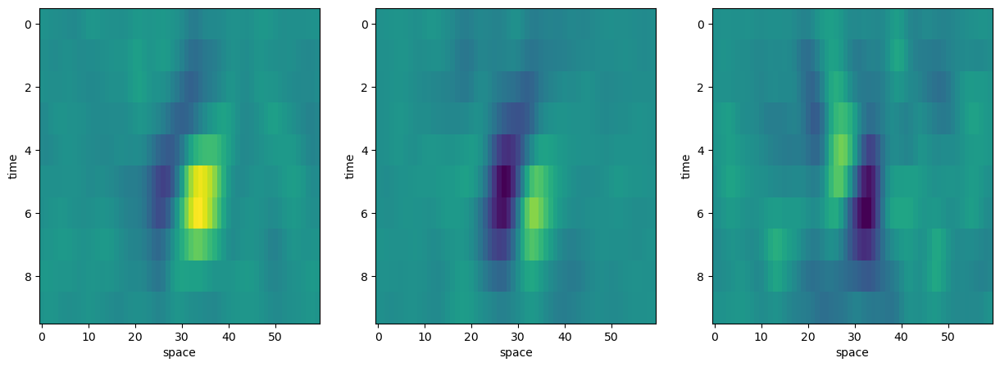

In [29]:
# take a vertical slice of each of the linear and quadratic receptive fields to plot in a single image
x = 33
plt.figure(figsize=(15,5))
linear_slice = linear[:, x, :]
quad0_slice = quad0[:, x, :]
quad1_slice = quad1[:, x, :]
plt.subplot(1,3,1)
imagesc(linear_slice)
plt.xlabel('space')
plt.ylabel('time')
plt.subplot(1,3,2)
imagesc(quad0_slice)
plt.xlabel('space')
plt.ylabel('time')
plt.subplot(1,3,3)
imagesc(quad1_slice)
plt.xlabel('space')
plt.ylabel('time')

# CNNs

## load models

In [15]:
cnns = []
for i in range(4, 31):
    with open('models/cnns_02/cnn_'+str(i)+'.pkl', 'rb') as f:
        cnns.append(pickle.load(f))

with open('models/cnns_02/study.pkl', 'rb') as f:
    study = pickle.load(f)

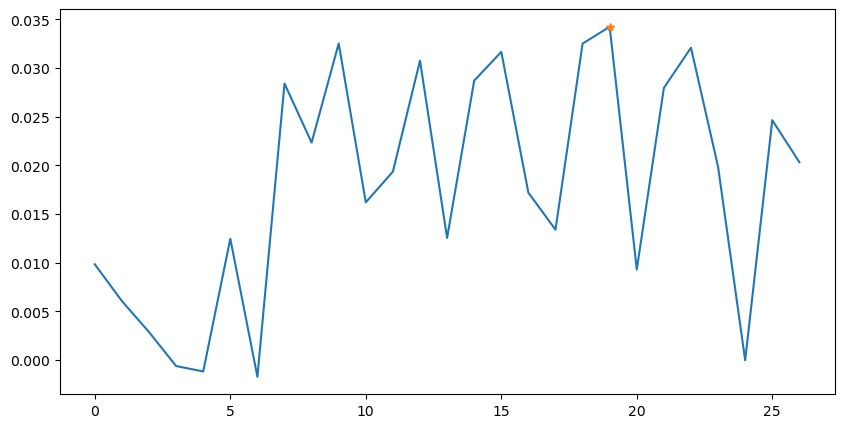

19


In [16]:
# plot LLs
fig = plt.figure(figsize=(10, 5))
plt.plot([np.mean(cnn.LLs) for cnn in cnns])
# put an asterisk on the best model
plt.plot(study.best_trial.number-3, np.mean(cnns[study.best_trial.number-3].LLs), '*')
plt.show()

print(study.best_trial.number-3)

best_cnn = cnns[study.best_trial.number-3].ndn_model

0.00984167984162254


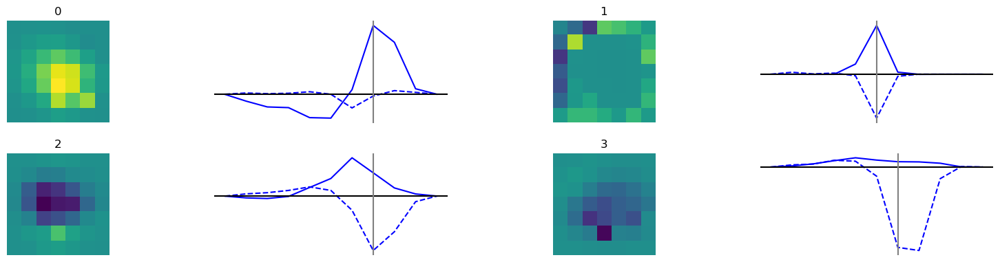

0.0060648260445430365


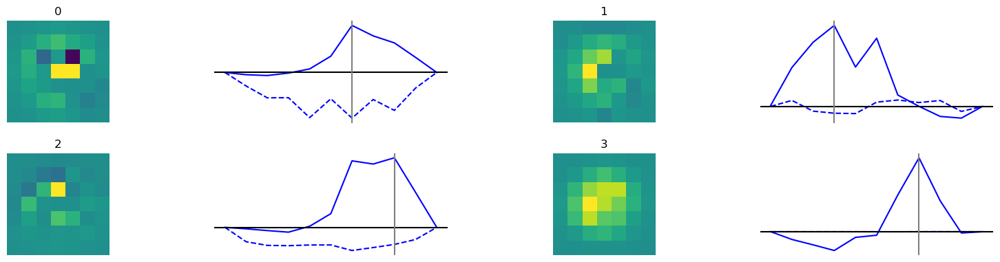

0.002881436512388032


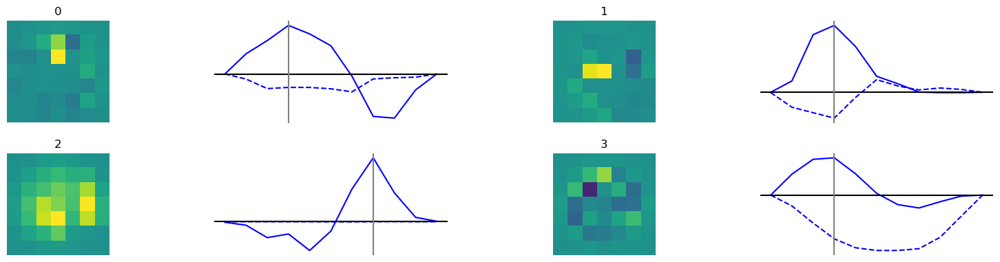

-0.0006094931185930625


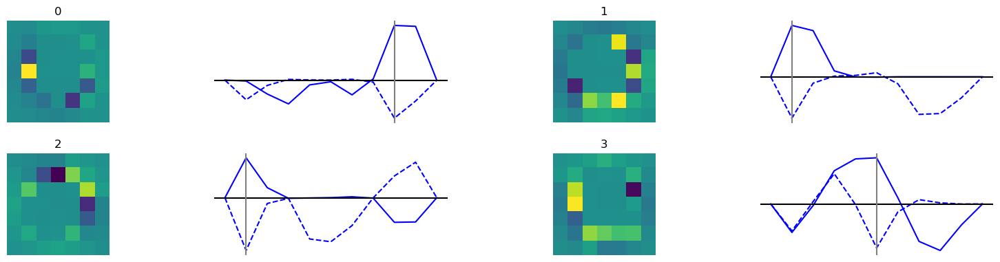

-0.0011662929907612417


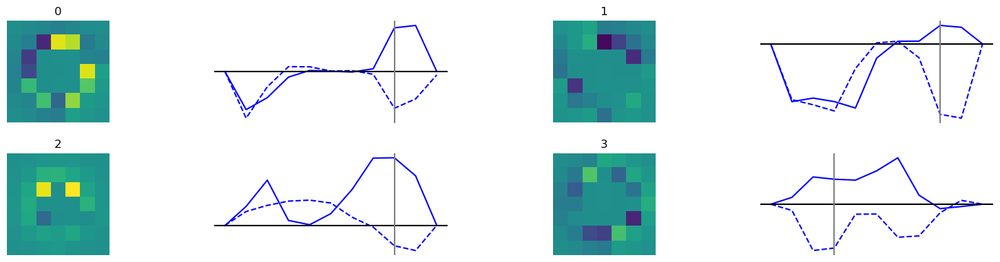

0.012464143078902671


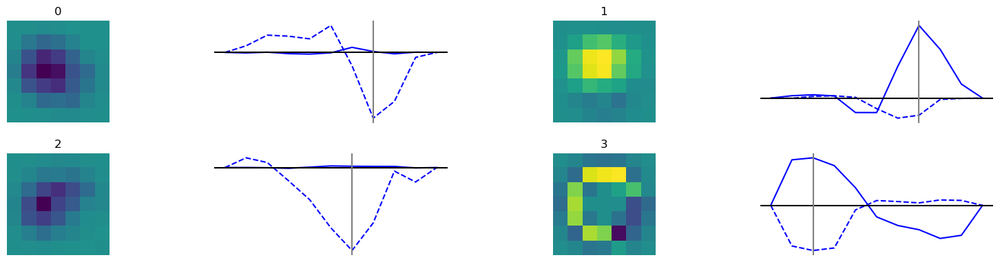

-0.001711833065953748


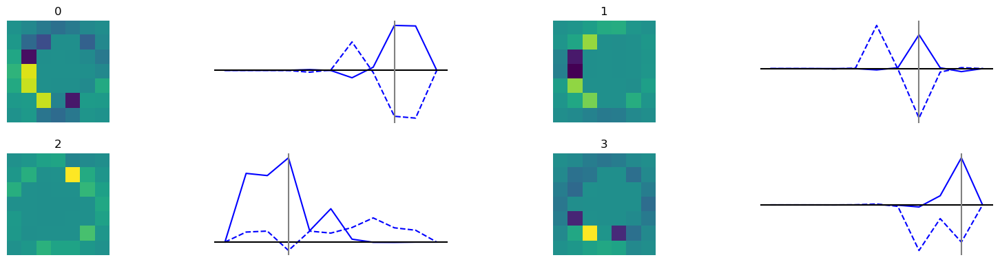

0.028404618816814203


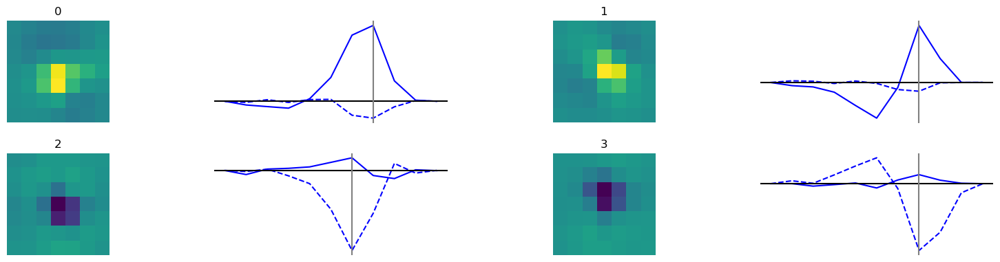

0.022346118400836813


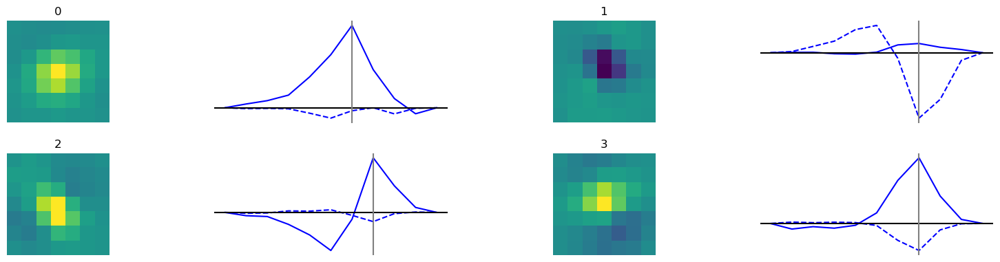

0.03252218166987101


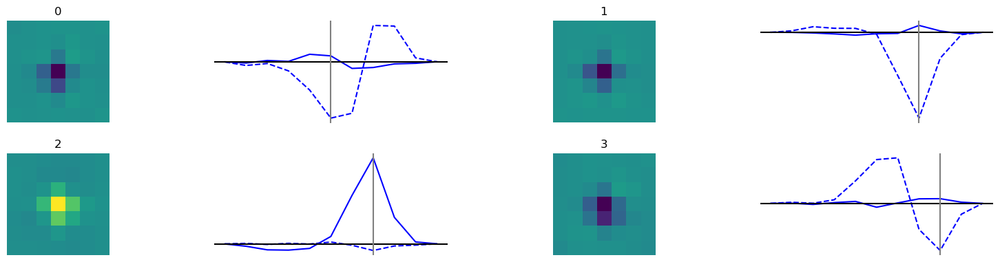

0.016203880995169454


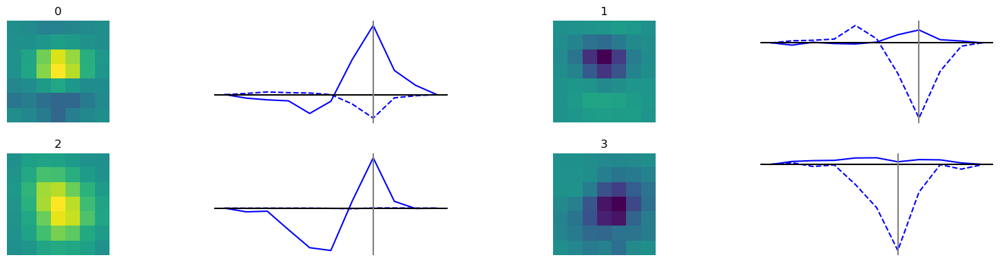

0.019362931278930313


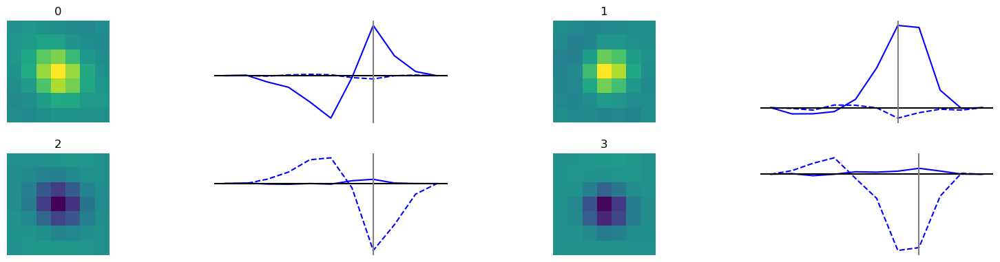

0.03076378984012823


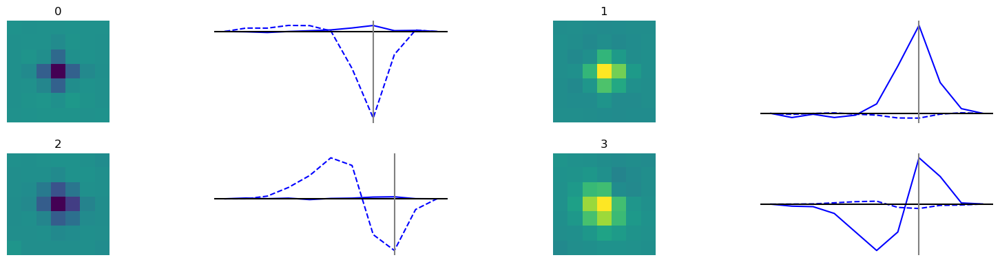

0.0125508198792907


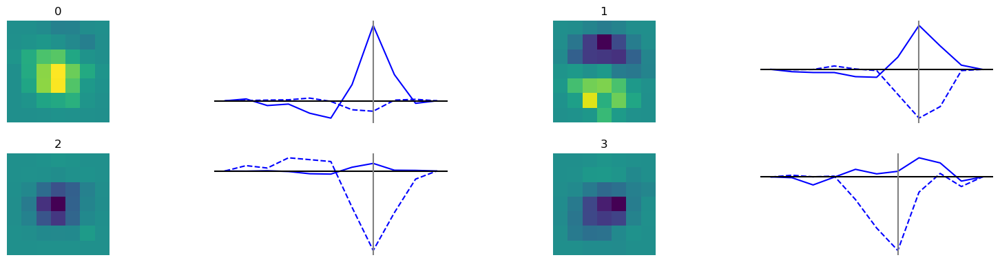

0.028706429333522403


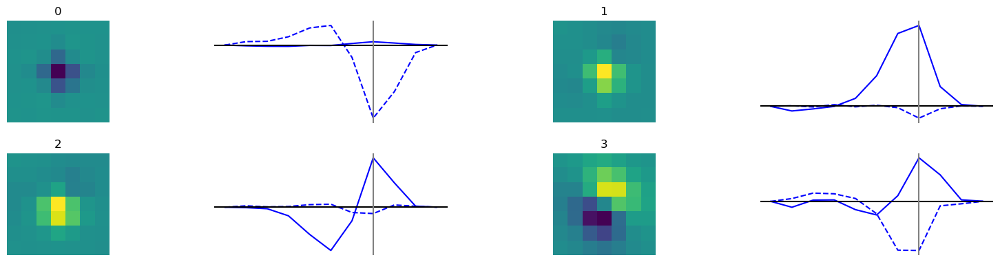

0.031656405706515255


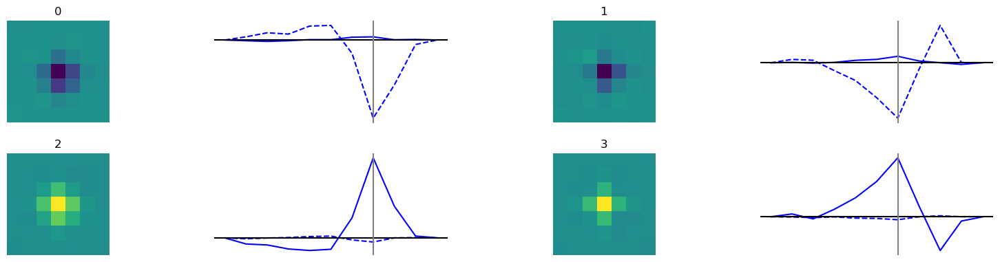

0.01719658813257327


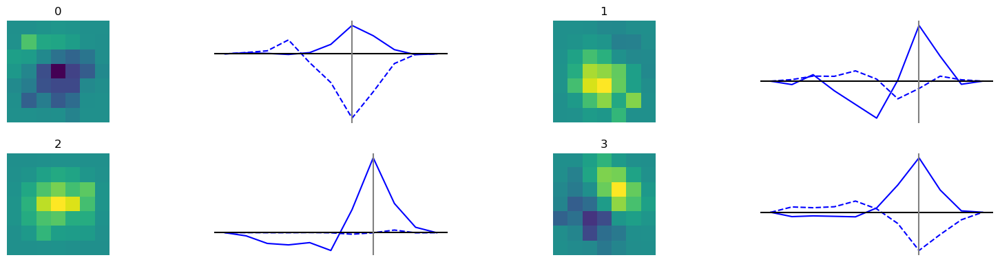

0.01339713663890444


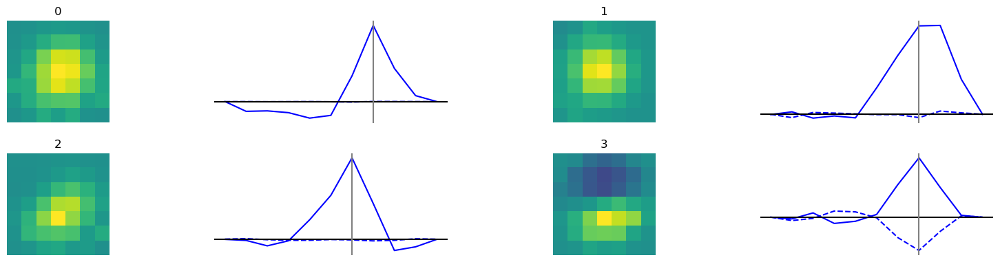

0.03251257778584272


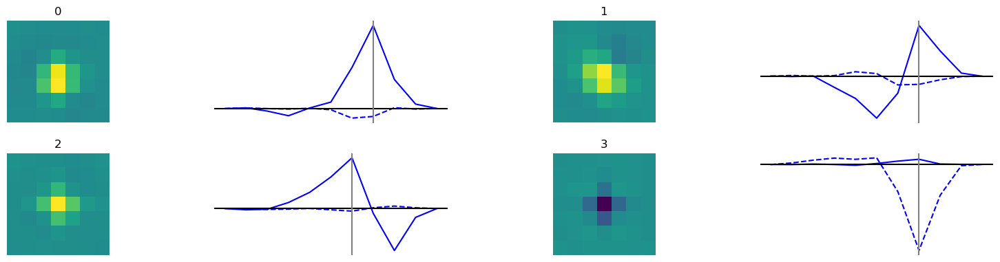

0.0342388591547122


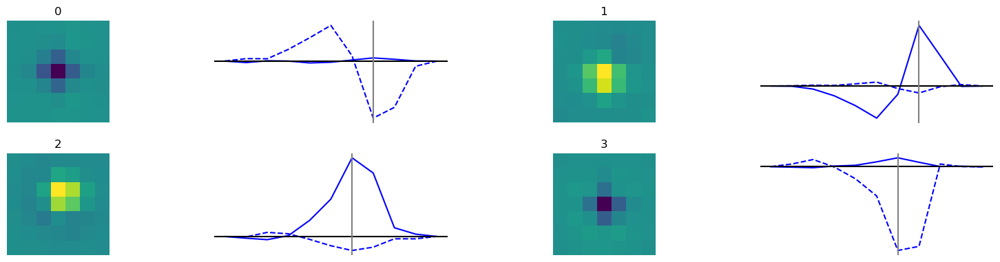

0.0093093562400204


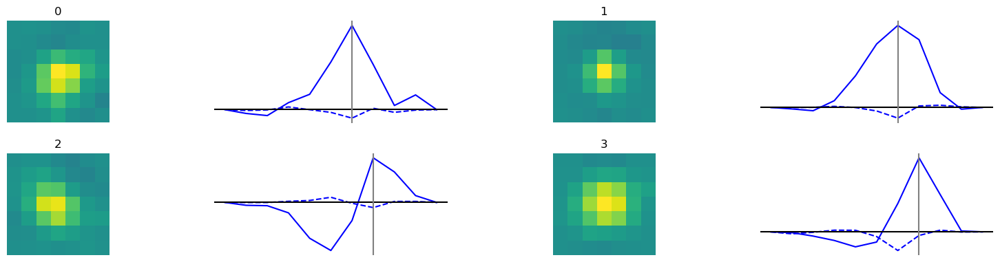

0.027960161368052166


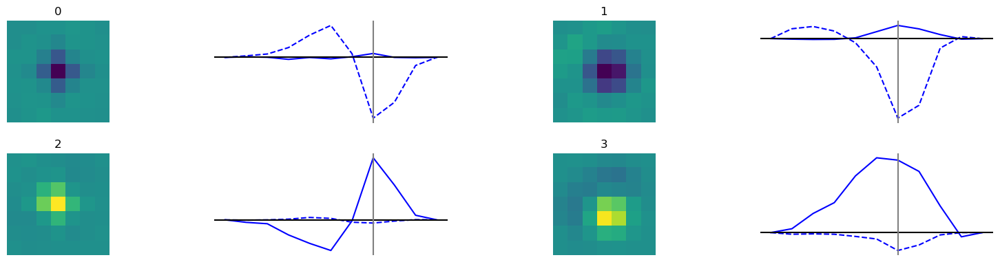

0.03208739045022548


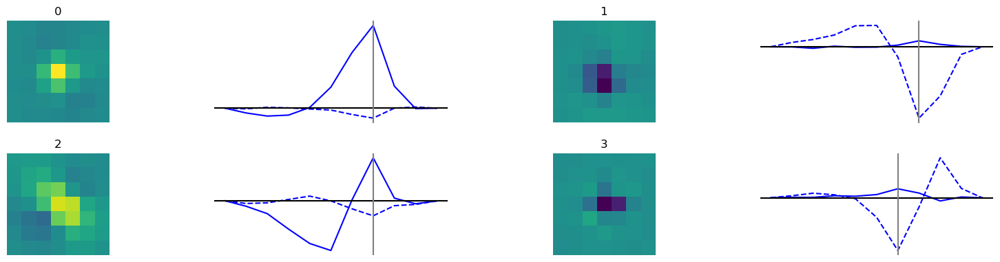

0.019857694362771922


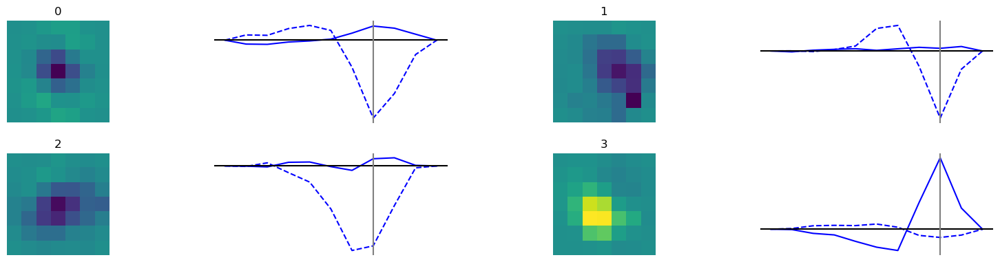

-2.1696775809101674e-05


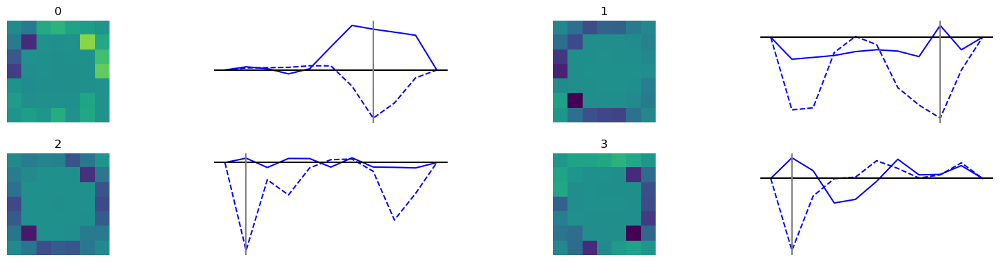

0.02464507914137566


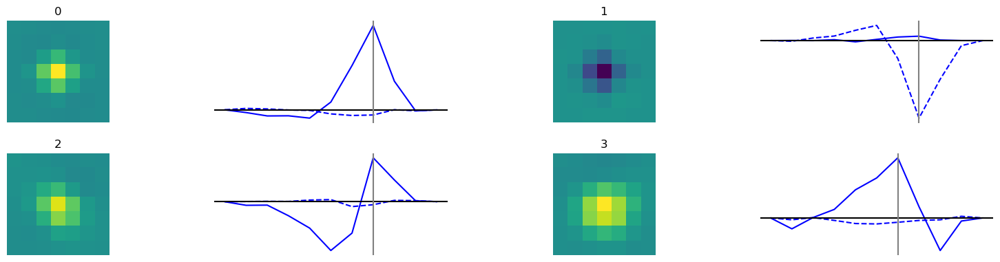

0.02033150607141955


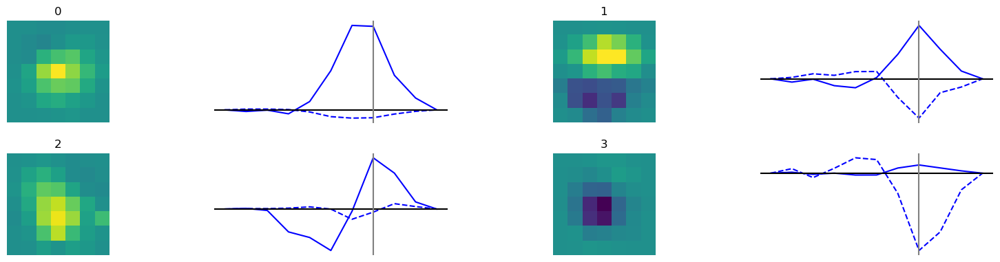

In [69]:
for cnn in cnns:
    print(np.mean(cnn.LLs))
    cnn.ndn_model.plot_filters()
    plt.show()

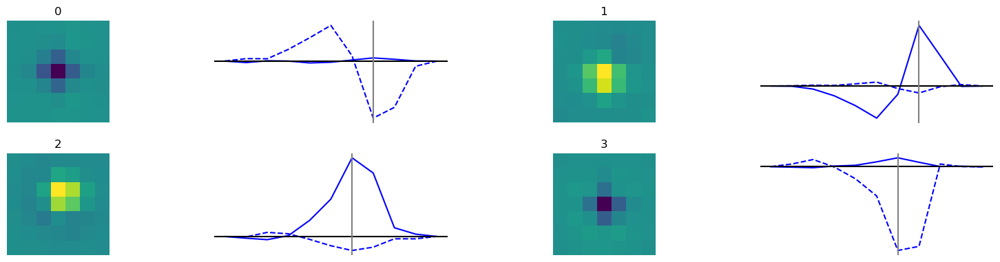

In [17]:
best_cnn.plot_filters()

## best parameters

In [56]:
trials = study.trials

# sort trials by values[0]
fig = plt.figure(figsize=(25, 10))
trials = sorted(trials, key=lambda x: x.values[0] if x.values is not None else -100)

<Figure size 2500x1000 with 0 Axes>

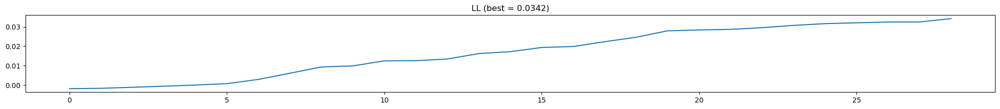

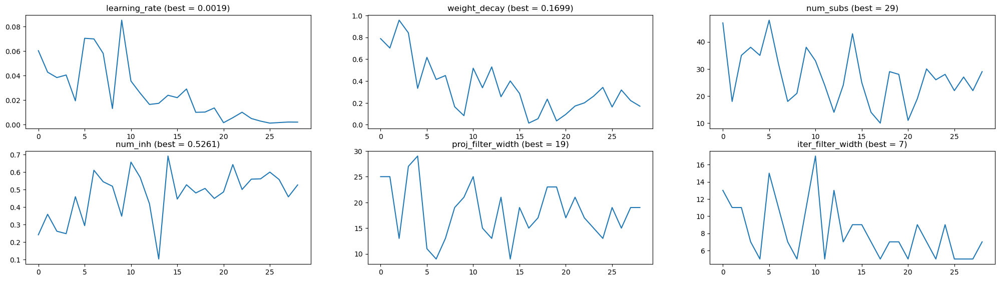

In [64]:
fig = plt.figure(figsize=(25, 2))
plt.plot([trial.values[0] for trial in trials if trial.values is not None])
plt.title('LL (best = ' + '%.4f' % trials[-1].values[0] + ')')
plt.show()

fig = plt.figure(figsize=(25, 10))
grid = matplotlib.gridspec.GridSpec(3, 3, hspace=0.2, wspace=0.2)
for i, k in enumerate(trials[-1].params.keys()):
    row,col = np.unravel_index(i, (3,3))
    plt.subplot(grid[row,col])
    plt.plot([trial.params[k] for trial in trials if trial.values is not None])
    # if number is a float
    if isinstance(trials[-1].params[k], float):
        plt.title(k + ' (best = ' + '%.4f' % trials[-1].params[k] + ')')
    else:
        plt.title(k + ' (best = ' + str(trials[-1].params[k]) + ')')

## predict from the CNN

In [18]:
pred = best_cnn.generate_predictions(data, batch_size=10)

Eval models: 100%|██████████████████████████████████████████████████████████████████████████████████████████| 70/70 [08:01<00:00,  6.88s/it]


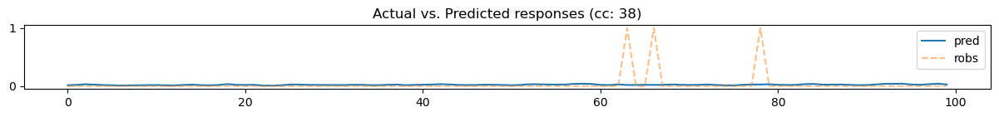

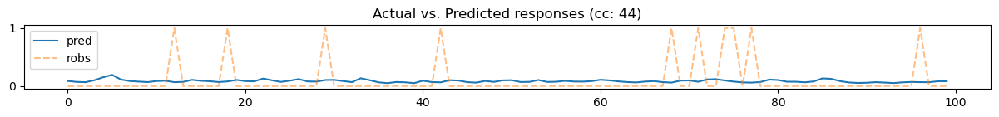

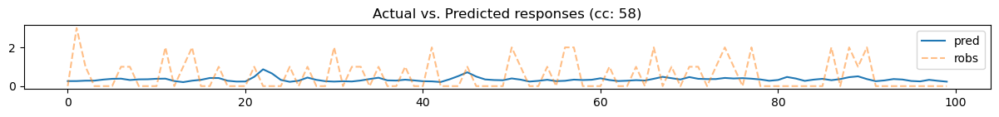

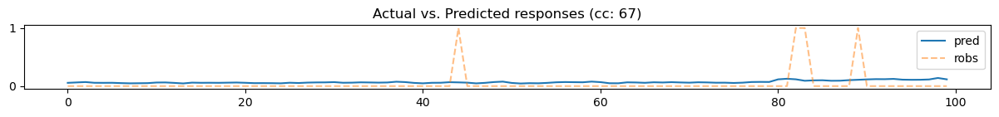

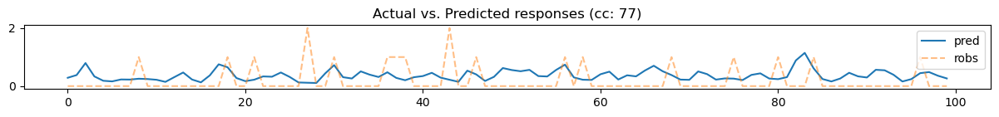

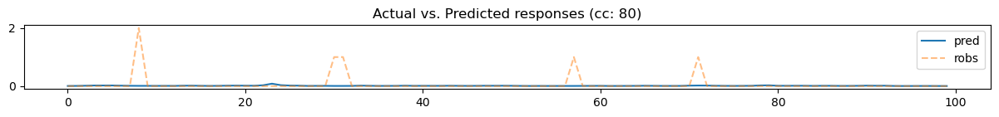

In [91]:
# plot preds vs. robs for each cell
for cc in interesting_cells:
    plt.figure(figsize=(15,1))
    plt.plot(pred[10000:10100, cc], label='pred')
    plt.plot(data.robs[10000:10100, valET[cc]], label='robs', linestyle='--', alpha=0.5)
    plt.title('Actual vs. Predicted responses (cc: ' + str(valET[cc]) + ')')
    plt.legend()
    plt.show()

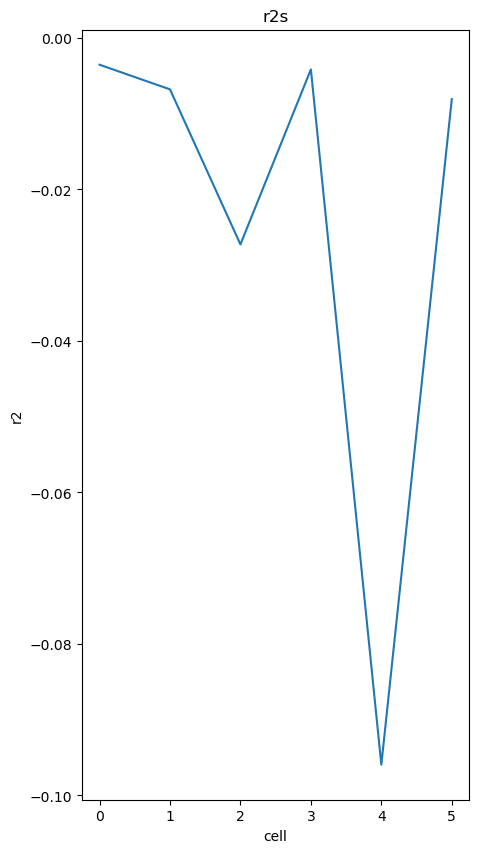

In [95]:
def r_squared(pred, robs):
    return 1 - torch.sum((pred - robs)**2) / torch.sum((robs -torch.mean(robs))**2)

# calculate r2 for each cell
r2s = []
for cc in interesting_cells:
    r2 = r_squared(pred[:, cc], data.robs[:, valET[cc]])
    r2s.append(r2)
    
# plot r2s
plt.figure(figsize=(5,10))
plt.plot(r2s)
plt.title('r2s')
plt.xlabel('cell')
plt.ylabel('r2')
plt.show()

In [45]:
pred.shape, data.robs.shape

(torch.Size([167520, 174]), torch.Size([167520, 239]))

In [46]:
# set the robs in the data to the predicted robs
data.robs = pred

# STAs from pred

In [96]:
Reff = torch.mul(pred, data.dfs[:, valET])
nspks = torch.sum(Reff, axis=0)
lag = 4
stas = ((data.stim[:-lag, ...].T @ Reff[lag:,:]).squeeze() / nspks).reshape([60,60,-1]).numpy()
stas.shape

(60, 60, 174)

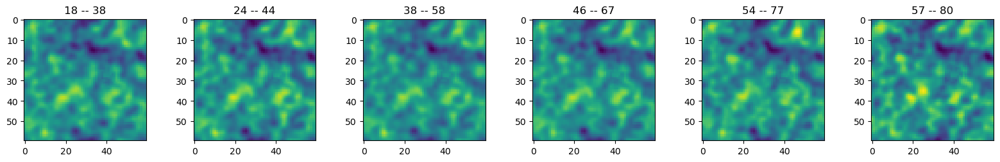

In [99]:
# plot STAs
ss(1,6)
for i, cc in enumerate(interesting_cells):
    plt.subplot(1,6, i+1)
    imagesc(stas[:,:, cc])
    plt.title(str(cc) + ' -- ' + str(valET[cc]))
plt.show()

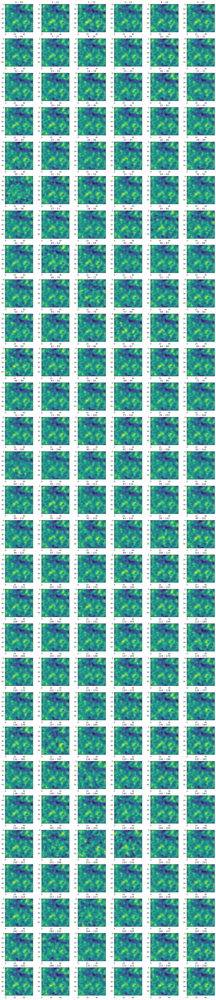

In [97]:
# plot STAs
ss(29,6)
for cc in range(NCv):
    plt.subplot(29,6, cc+1)
    imagesc(stas[:,:, cc])
    plt.title(str(cc) + ' -- ' + str(valET[cc]))
plt.show()

## fit Drift from pred

In [51]:
drifts = []
for i, cc in enumerate(interesting_cells):
    drift = fit_drift(i, cc, folder='glms_03_pred')[0]
    drifts.append(drift)

loading model 18
loading model 24
loading model 38
loading model 46
loading model 54
loading model 57


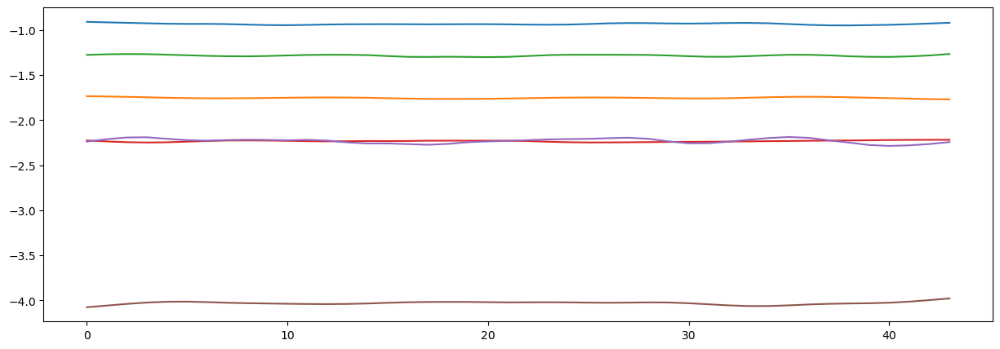

In [58]:
fig = plt.figure(figsize=(15,5))
for drift in drifts:
    plt.plot(drift.ndn_model.networks[0].layers[0].get_weights())

## fit GLM from pred

In [59]:
glms = []
for i, cc in enumerate(interesting_cells):
    glm = fit_glm(i, cc, folder='glms_03_pred')[0]
    glms.append(glm)

loading model 18
loading model 24
loading model 38
loading model 46
loading model 54
loading model 57


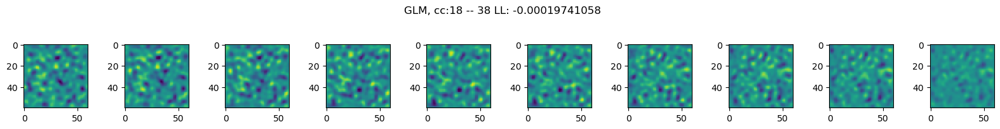

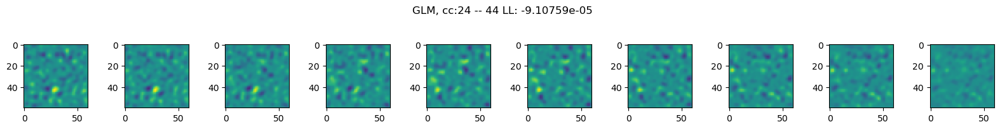

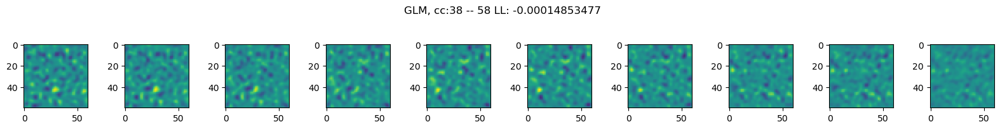

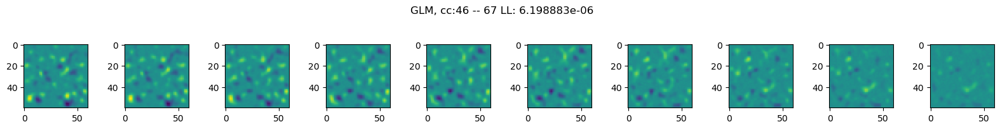

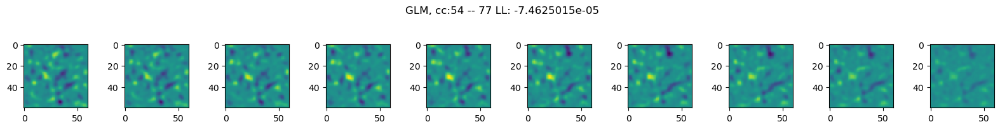

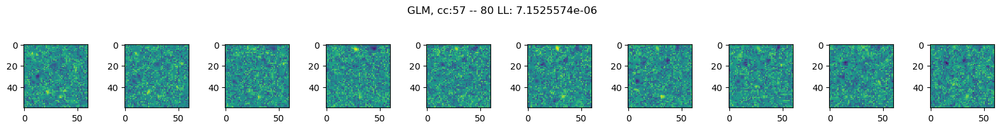

In [60]:
for i, cc in enumerate(interesting_cells):
    max_weights = np.max(glms[i].ndn_model.networks[0].layers[0].get_weights())
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(glms[i].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GLM, cc:' + str(cc) + ' -- ' + str(valET[cc]) + ' LL: ' + str(glms[i].LLs))
        col += 1
    plt.show()

## fit GQM from pred

In [ ]:
gqms = []
gqm_studies = []
for i, cc in enumerate(range(0, 84)):
    gqm, study = fit_gqm(i, cc, 'glms_03_pred')
    gqms.append(gqm)
    gqm_studies.append(study)

-------------


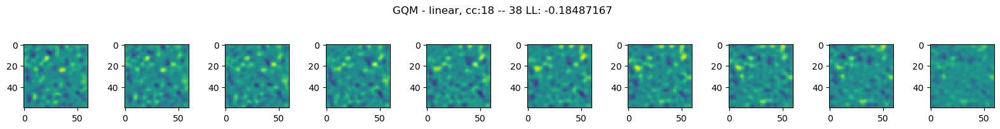

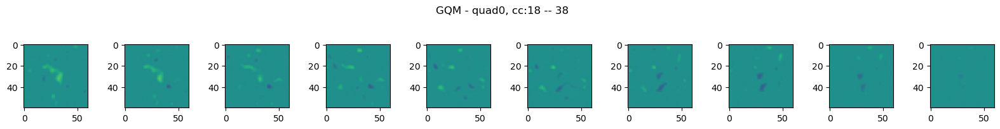

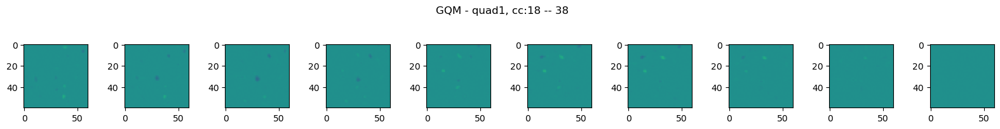

-------------


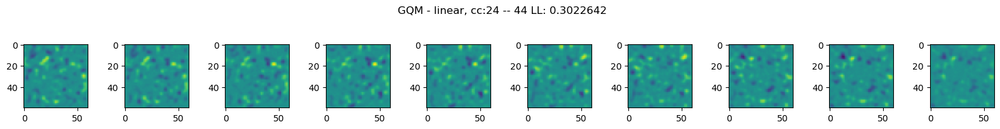

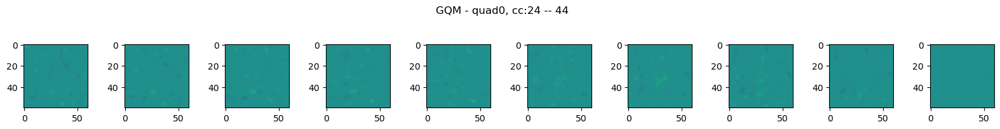

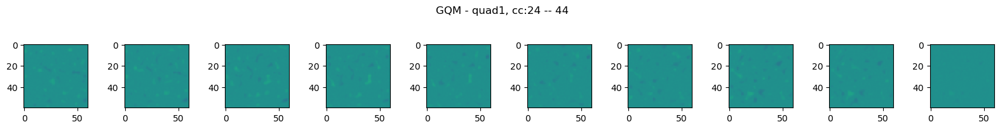

-------------


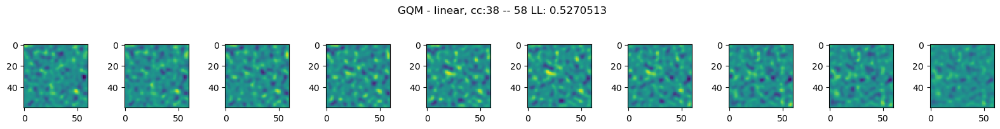

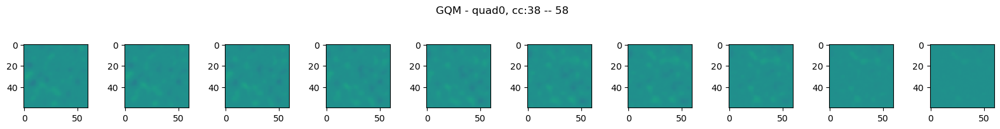

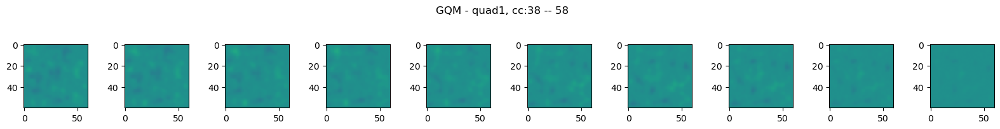

-------------


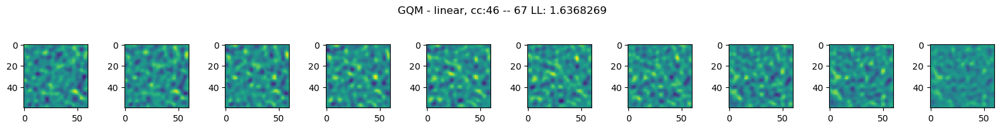

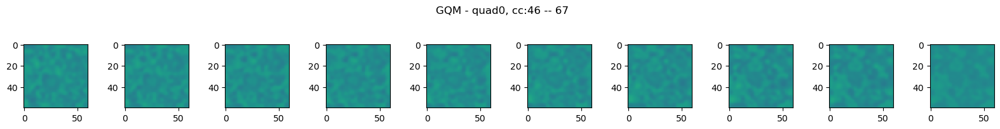

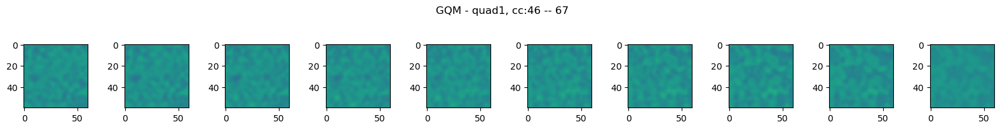

-------------


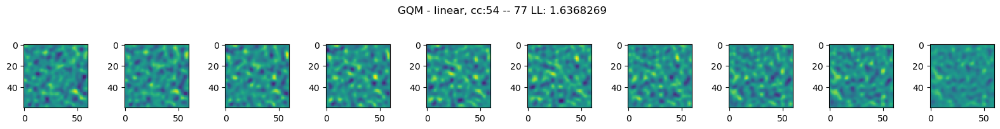

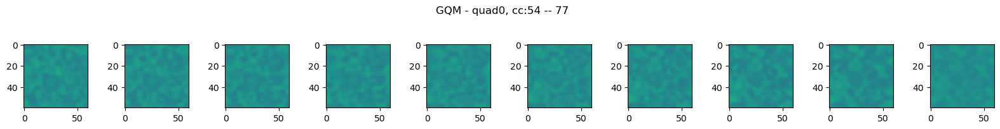

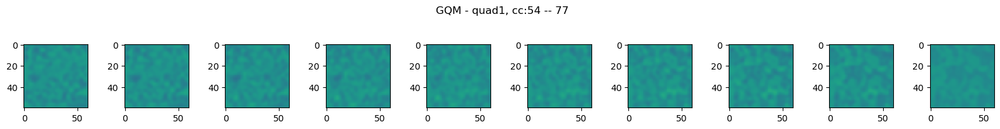

-------------


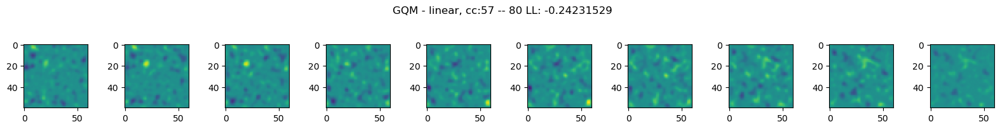

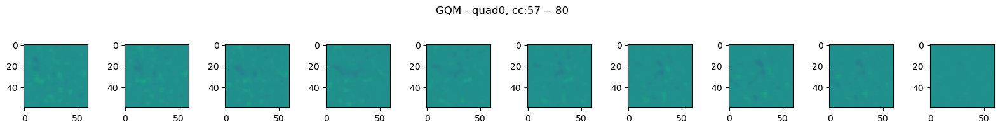

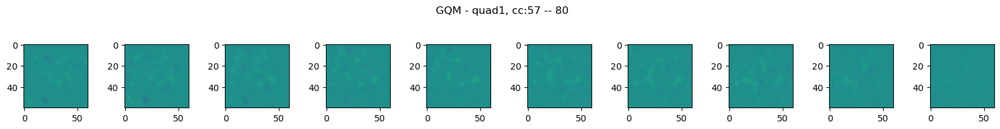

In [71]:
# plot filters
for i, cc in enumerate(interesting_cells):
    max_weights = 0
    weights_lin = np.max(gqms[i].ndn_model.networks[0].layers[0].get_weights())
    weights_quad = np.max(gqms[i].ndn_model.networks[2].layers[0].get_weights())
    if weights_lin > max_weights:
        max_weights = weights_lin
    if weights_quad > max_weights:
        max_weights = weights_quad

    print('-------------')
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(gqms[i].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - linear, cc:' + str(cc) + ' -- ' + str(valET[cc]) + ' LL: ' + str(gqms[i].LLs))
        col += 1
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(gqms[i].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - quad0, cc:' + str(cc) + ' -- ' + str(valET[cc]))
        col += 1
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(gqms[i].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 1], max=max_weights)
        plt.suptitle('GQM - quad1, cc:' + str(cc) + ' -- ' + str(valET[cc]))
        col += 1
    plt.show()